In [450]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import ascii, votable
from astropy.table import Table, vstack, hstack, Column
import astropy.units as u

dir_rrlyrae = '/datascope/menard/group/scheng/Gaia/'
dir_WD = '/home/scheng/Gaia/'

In [2]:
isochrone_sun = Table.read('/home/scheng/Gaia/5Gyr_0.0152.dat',format='ascii')
isochrone_old = Table.read('/home/scheng/Gaia/10Gyr_0.0152.dat',format='ascii')
isochrone_mpoor = Table.read('/home/scheng/Gaia/10Gyr_0.000152.dat',format='ascii')
isochrone_old

Zini,Age,Mini,Mass,logL,logTe,logg,label,McoreTP,C_O,period0,period1,pmode,Mloss,tau1m,X,Y,Xc,Xn,Xo,Cexcess,Z,mbolmag,Gmag,G_BPmag,G_RPmag
float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
0.0152,10000000000.0,0.0900000036,0.09,-3.423,3.3625,5.217,1,0.0,0.545,0.0,0.0,-1,0.0,0.0,0.708,0.2767,0.002746,0.0007408,0.006719,-1.0,0.01527,13.327,15.495,18.812,14.112
0.0152,10000000000.0,0.1000000015,0.1,-3.24,3.3884,5.184,1,0.0,0.545,0.0,0.0,-1,0.0,0.0,0.7076,0.2771,0.002746,0.0007408,0.006719,-1.0,0.01527,12.871,14.758,17.793,13.398
0.0152,10000000000.0,0.1077039689,0.108,-3.133,3.4026,5.165,1,0.0,0.545,0.0,0.0,-1,0.0,0.0,0.7072,0.2775,0.002746,0.0007408,0.006719,-1.0,0.01527,12.601,14.346,17.188,13.003
0.0152,10000000000.0,0.1200000122,0.12,-2.975,3.4232,5.137,1,0.0,0.545,0.0,0.0,-1,1.04e-16,0.0,0.7067,0.278,0.002746,0.0007408,0.006719,-1.0,0.01527,12.209,13.759,16.281,12.449
0.0152,10000000000.0,0.1400000006,0.14,-2.792,3.4435,5.102,1,0.0,0.545,0.0,0.0,-1,1.53e-16,0.0,0.706,0.2788,0.002746,0.0007408,0.006719,-1.0,0.01527,11.749,13.11,15.333,11.84
0.0152,10000000000.0,0.1496137679,0.15,-2.721,3.4502,5.087,1,0.0,0.545,0.0,0.0,-1,0.0,0.0,0.7056,0.2791,0.002746,0.0007408,0.006719,-1.0,0.01527,11.573,12.877,15.0,11.622
0.0152,10000000000.0,0.1599999964,0.16,-2.65,3.4571,5.073,1,0.0,0.545,0.0,0.0,-1,0.0,0.0,0.7053,0.2794,0.002746,0.0007408,0.006719,-1.0,0.01527,11.395,12.643,14.665,11.403
0.0152,10000000000.0,0.200000003,0.2,-2.43,3.4758,5.025,1,0.0,0.545,0.0,0.0,-1,0.0,0.0,0.7042,0.2806,0.002746,0.0007408,0.006719,-1.0,0.01527,10.846,11.953,13.725,10.759
0.0152,10000000000.0,0.25,0.25,-2.217,3.4921,4.974,1,0.0,0.545,0.0,0.0,-1,0.0,0.0,0.7033,0.2814,0.002746,0.0007408,0.006719,-1.0,0.01527,10.314,11.305,12.894,10.151


## load npy file

In [3]:
WD = np.load(dir_rrlyrae+'/WD2.npy')[0]['WD2']
len(WD)

1078686

In [34]:
WD['source_id','random_index'][selected_WD].write('WD2_source_id_selected.csv',format='csv',overwrite=True)

In [943]:
sdss = np.load(dir_WD+'/WD_sdss.npy')[0]['WD_sdss']
tmass = np.load(dir_WD+'/WD_tmass.npy')[0]['WD_tmass'] 
panstarrs = np.load(dir_WD+'/WD_panstarrs.npy')[0]['WD_panstarrs'] 
wise = np.load(dir_WD+'/WD_wise.npy')[0]['WD_wise']
sdss_ra_dec = np.load(dir_WD+'/WD_sdss_ra_dec.npy')[0]['ra_dec']

## define variables

In [816]:
table = WD
bp_rp = np.array(table['bp_rp'])
g = np.array(table['phot_g_mean_mag'])
l = table['l']
b = table['b']
ra = table['ra']
dec = table['dec']

d = 1 / np.array(table['parallax'])*u.kpc
e_d = d * np.array(table['parallax_error']/table['parallax'])
X = - d * np.array(np.cos(b/180*np.pi) * np.cos(l/180*np.pi))
Y = d * np.array(np.cos(b/180*np.pi) * np.sin(l/180*np.pi))
Z = d * np.array(np.sin(b/180*np.pi))
pmra = np.array(table['pmra'])*1*u.mas/u.yr
pmdec = np.array(table['pmdec'])*1*u.mas/u.yr
pm_abs = np.sqrt(pmra**2 + pmdec**2)

In [809]:
selected = np.where(\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
             * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)
           )[0]
len(selected)

73067

### load known DAV catalog and match them with Gaia WD

In [5]:
text = np.genfromtxt('DAV_coor.txt',delimiter=' ',)
sign = np.genfromtxt('DAV_coor.txt',delimiter=' ',dtype=str,usecols=(3))=='+'
ra = (text[:,0] + text[:,1]/60 + text[:,2]/3600) * 15
dec = text[:,4] + text[:,5]/60 + text[:,6]/3600 * (sign*2-1)

In [6]:
text = np.genfromtxt('DAV.txt',delimiter='\t',dtype=str,usecols=(4,5,6,7)) # T_eff, log g, V, amp
text = Table(text,names=('T','logg','V','amp'),dtype=(float,float,float,float))
DAV_known = text
DAV_known['ra'] = ra
DAV_known['dec'] = dec

In [7]:
selected = np.where(\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
             * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)
           )[0]

best_match = np.empty(len(DAV_known))
best_match.astype(int)
dist = np.empty(len(DAV_known))
for i in range(len(DAV_known)):
    distance = ( (DAV_known['ra'][i] - WD['ra'][selected])**2 * np.cos(DAV_known['dec'][i]/180*np.pi)**2 + \
         (DAV_known['dec'][i] - WD['dec'][selected])**2 )**0.5
    best_match[i] = selected[np.where(distance == distance.min())[0]]
    dist[i] = distance.min()
DAV_known['index'] = best_match.astype(int)
DAV_known['dist'] = dist

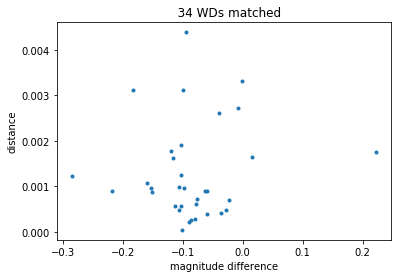

In [8]:
DAV_selected = (DAV_known['dist']<0.1) * \
     (np.abs(DAV_known['V']-WD['phot_g_mean_mag'][DAV_known['index']]+0.1)<1)
x1 = DAV_known['V']-WD['phot_g_mean_mag'][DAV_known['index']]
x2 = DAV_known['dist']
plt.plot(x1[DAV_selected],x2[DAV_selected],'.')
plt.ylabel('distance')
plt.xlabel('magnitude difference')
plt.title('%5i WDs matched' % (DAV_selected.sum()))
plt.show()
DAV_index = DAV_known['index'][DAV_selected]
## data product:  DAV_known[selected], [DAV_known['index'][selected]]

In [811]:
selected_WD = (\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
               * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)\
           )# * (np.abs(bp_rp-0.02)<0.1)
selected_WD.sum()

73067

## import dustmap

In [6]:
from astropy.coordinates import SkyCoord
from dustmaps.planck import PlanckQuery
from dustmaps.sfd import SFDQuery
from dustmaps.bayestar import BayestarQuery

from dustmaps.config import config
config['data_dir'] = '/datascope/menard/group/scheng/dust/dustmaps'

coords = SkyCoord(l, b, distance=d, frame='galactic')

#planck = PlanckQuery()
#planck(coords)

sfd = SFDQuery()
sfd_ext = sfd(coords)

#bayestar = BayestarQuery() # Bayestar2017 is the default
#bayestar_ext = bayestar(coords, mode='median')

/home/scheng/miniconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


## Correctness of Crossmatch for SDSS and Panstarrs

In [944]:
sdss['index'] = np.arange(len(sdss))

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in greater
  """
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in less
  """
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in greater
  import sys
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in less
  import sys


18495
20564


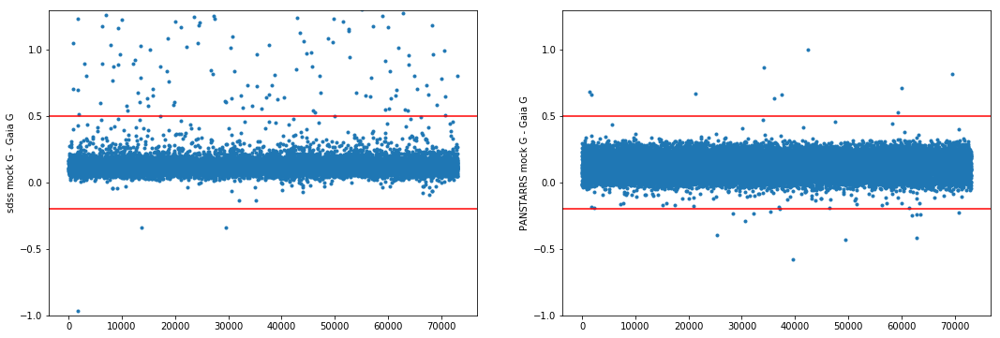

In [945]:
selected = ((d/e_d)[selected_WD]>10)
sdss_mock_G = np.array(sdss['u_mag']*0.06+sdss['g_mag']*0.3+sdss['r_mag']*0.3+sdss['i_mag']*0.2+sdss['z_mag']*0.14)
pan_mock_G = np.array(panstarrs['g_mean_psf_mag']*0.3+panstarrs['r_mean_psf_mag']*0.3+\
                      panstarrs['i_mean_psf_mag']*0.2+panstarrs['z_mean_psf_mag']*0.2)

selected_sdss = (sdss_mock_G - g[selected_WD] > -0.2) * (sdss_mock_G - g[selected_WD] < 0.5)
print(selected_sdss.sum())
selected_pan = (pan_mock_G - g[selected_WD] > -0.2) * (pan_mock_G - g[selected_WD] < 0.5)
print(selected_pan.sum())

plt.figure(figsize=(18,6))
plt.subplot(1,2,1)
plt.plot(sdss_mock_G-g[selected_WD],'.')
plt.axhline(-0.2,c='r')
plt.axhline(0.5,c='r')
plt.ylim(-1,1.3)
plt.ylabel('sdss mock G - Gaia G')

plt.subplot(1,2,2)
plt.plot(pan_mock_G-g[selected_WD],'.')
plt.axhline(-0.2,c='r')
plt.axhline(0.5,c='r')
plt.ylim(-1,1.3)
plt.ylabel('PANSTARRS mock G - Gaia G')
plt.show()

In [947]:
sdss[np.where(sdss['source_id']==1617015089130028544)]# 68083

sdssdr9_oid,obj_id,thing_id,ra,dec,ra_error,dec_error,mjd,u_mag,u_mag_error,g_mag,g_mag_error,r_mag,r_mag_error,i_mag,i_mag_error,z_mag,z_mag_error,objc_type,clean_flag,sdss_d,source_id,index
,,,deg,deg,arcs,arcs,d,mag,mag,mag,mag,mag,mag,mag,mag,mag,mag,,,arcs,,
int64,object,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int32,int32,float64,int64,int64
441315500,1237654398627152025,523650732,221.7809001383916,58.918545993708925,0.011762900531792906,0.011648225853637841,51935.0,19.243023,0.024154076,19.069366,0.021712193,19.340097,0.022115227,19.547953,0.02690489,19.710695,0.09960183,6,1,0.06278171166126689,1617015089130028544,68083


## Split in HR diagram

### SDSS WD

In [948]:
np.save('WD_table_sdss.npy',np.array([{'table':WD[selected_WD][selected_sdss],'sdss':sdss[selected_sdss]}])) 
## transport this to local computer
len(table)

18495

In [934]:
WD_bp_rp = bp_rp[selected_WD]
WD_bp = WD['phot_bp_mean_mag'][selected_WD]
WD_rp = WD['phot_rp_mean_mag'][selected_WD]
WD_u = sdss['u_mag']
WD_g = sdss['g_mag']
WD_r = sdss['r_mag']
WD_i = sdss['i_mag']
WD_z = sdss['z_mag']
WD_G = WD['phot_g_mean_mag'][selected_WD]

In [861]:
table = WD['bp_rp','phot_bp_mean_mag'][0:selected_sdss.sum()]

In [862]:
table['bp_rp'] = (WD_bp_rp)[selected_sdss]
table['bp'] = (WD_bp - WD_m_M)[selected_sdss]
table['rp'] = (WD_rp - WD_m_M)[selected_sdss]
table['u'] = (WD_u - WD_m_M)[selected_sdss]
table['g'] = (WD_g - WD_m_M)[selected_sdss]
table['r'] = (WD_r - WD_m_M)[selected_sdss]
table['i'] = (WD_i - WD_m_M)[selected_sdss]
table['z'] = (WD_z - WD_m_M)[selected_sdss]
table['d'] = d[selected_WD].value[selected_sdss]
table['snr'] = (d/e_d)[selected_WD][selected_sdss]
table['G'] = (WD_G - WD_m_M)[selected_sdss]

In [863]:
table.write('WD_Gaia_sdss.csv',format='csv',overwrite=True)

## list of WD for getting spectra from SDSS

In [865]:
sdss_objid = Table.read('WD_sdss.csv')
sdss_objid['index1'] = np.arange(len(sdss))

In [866]:
sdss_objid['obj_id','thing_id','index1'][selected_sdss].write('WD_sdss_objid.csv',overwrite=True)

In [868]:
Table.read('WD_sdss_objid.csv')[0]

obj_id,thing_id,index1
int64,int64,int64
1237655691943936384,61494019,16


1. then download the csv file and upload it to Casjob
2. match the obj_id with SEGUE list and get PLATE, MJD, FIBERID
3. download from Casjob in .csv format
4. change the null into empty
6. upload the non-null PLATE, MJD, FIBERID to SEGUE spec query (limit of 1000 for each time)

In [869]:
selected_sdss.sum()

18495

### convert fits to npy

In [872]:
table = Table.read('WD_sdss_spectral_index_13000_all.csv',format='csv')
table.remove_rows(np.where(table['index1'][1:]-table['index1'][:-1] == 0))
len(table)

with_spec = table['MJD']!='null'
print(with_spec.sum())
table[with_spec][0]

4786


obj_id,MJD,PLATE,FIBERID,index1
str19,str5,str4,str4,int64
1237655691943936384,52409,924,163,16


In [878]:
from scipy.interpolate import interp1d
import os
from astropy.io import fits
from scipy.signal import medfilt

dir_WD_spectra = '/datascope/menard/group/scheng/Gaia/WD_spectra_all/'
name_list = os.listdir(dir_WD_spectra)
def open_one_spec_by_name_list(i,med_size=3,pl=True):
    name = name_list[i]
    hdul = fits.open(dir_WD_spectra+name)
    lam = 10**hdul[1].data['loglam']
    flux = hdul[1].data['flux']
    flux_med = medfilt(flux,med_size)
    func = interp1d(lam, flux_med, kind='linear', bounds_error=False, fill_value=(flux[0],flux[-1]), assume_sorted=True)
    lam_grid = lam_standard
    if pl==True:
        plt.figure(figsize=(18,6))
        plt.plot(lam_grid,func(lam_grid))
        plt.axvline(6563)
        plt.axvline(3646)
        plt.show()
    return lam_grid, func(lam_grid)

def open_one_spec(i,med_size=3,pl=True):
    name = 'spec-'+'%04i' % (int(table['PLATE'][i])) + '-' + '%5i' % (int(table['MJD'][i])) + '-' +\
                '%04i' % (int(table['FIBERID'][i]))+'.fits'
    
    hdul = fits.open(dir_WD_spectra+name)
    lam = 10**hdul[1].data['loglam']
    flux = hdul[1].data['flux']
    flux_med = medfilt(flux,med_size)
    func = interp1d(lam, flux_med, kind='linear', bounds_error=False, fill_value=(flux[0],flux[-1]), assume_sorted=True)
    lam_grid = lam_standard
    if pl==True:
        plt.figure(figsize=(18,6))
        plt.plot(lam_grid,func(lam_grid))
        plt.axvline(6563)
        plt.axvline(3646)
        plt.show()
    return lam_grid, func(lam_grid)

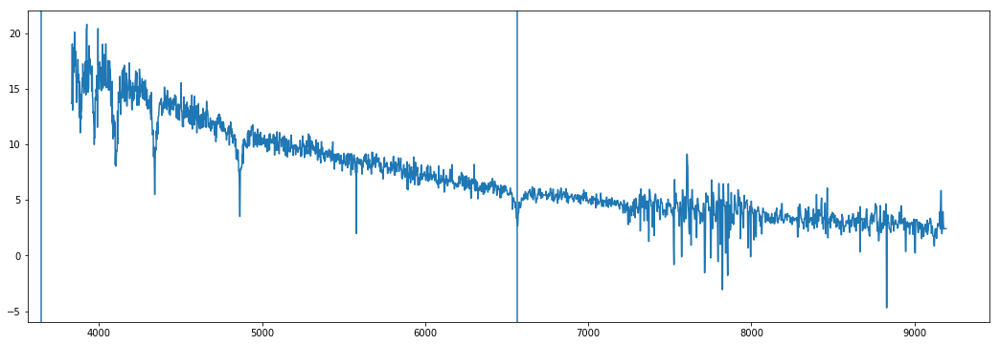

In [879]:
lam_standard,_ = open_one_spec_by_name_list(0,3)

### save spec.npy which contains all spectra

In [882]:
spec = np.empty((with_spec.sum(),len(lam_standard)))
for i,with_spec_index in enumerate(np.where(with_spec)[0]):
    a, spec[i,:] = open_one_spec(with_spec_index,5,pl=False)
#spec_norm = spec / spec.mean(axis=1).reshape(-1,1)
spec[np.isnan(spec)] = 1
np.save('WD_spec_unnorm.npy',np.array([{'spec':spec,'lam_standard':lam_standard,'name_list':name_list}]))

download the spec.npy to local computer and work at there. (finished)

scp scheng@dslogin01.pha.jhu.edu:/home/scheng/Gaia/WD_spec_unnorm.npy .

## sdss WD

In [883]:
data = np.load('WD_spec_unnorm.npy')[0]
spec = data['spec']
lam_standard = data['lam_standard']
name_list = data['name_list']

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in less
  
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in less
  import sys
/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:780: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:781: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


(array([   3,  112,  160,  197,  243,  254,  353,  484,  572,  574,  600,
        645,  701,  720,  721,  859,  863,  961, 1159, 1335, 1450, 1638,
       2327, 2601, 2887, 2899, 2989]),)


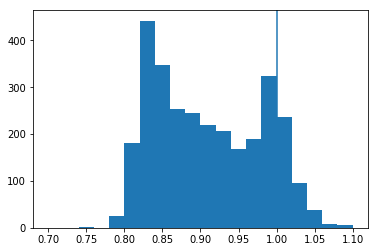

In [600]:
selected_with_spec = np.load('sdss_with_spec.npy')[0]['index']
H_alpha = spec[:,2300:2380].sum(axis=1) /80 / (spec[:,2300]+spec[:,2380]) * 2 * 0.4 + \
                    spec[:,985:1085].sum(axis=1)/100 / (spec[:,985]+spec[:,1085]) * 2 * 0.6
#H_alpha = spec[:,2340] / (spec[:,2300]+spec[:,2380]) * 2 * 0.4 + spec[:,1035] / (spec[:,985]+spec[:,1085]) * 2 * 0.6

DB = np.abs(H_alpha-0.99)<0.02
DA = H_alpha<0.80
#print(np.where(DA))
print(np.where(DA))
plt.hist(H_alpha,20,(0.7,1.1))
plt.axvline(1)
plt.show()

In [606]:
selected_with_spec_bool = np.zeros(13514,dtype=bool)
for i in selected_with_spec:
    selected_with_spec_bool[i]=True

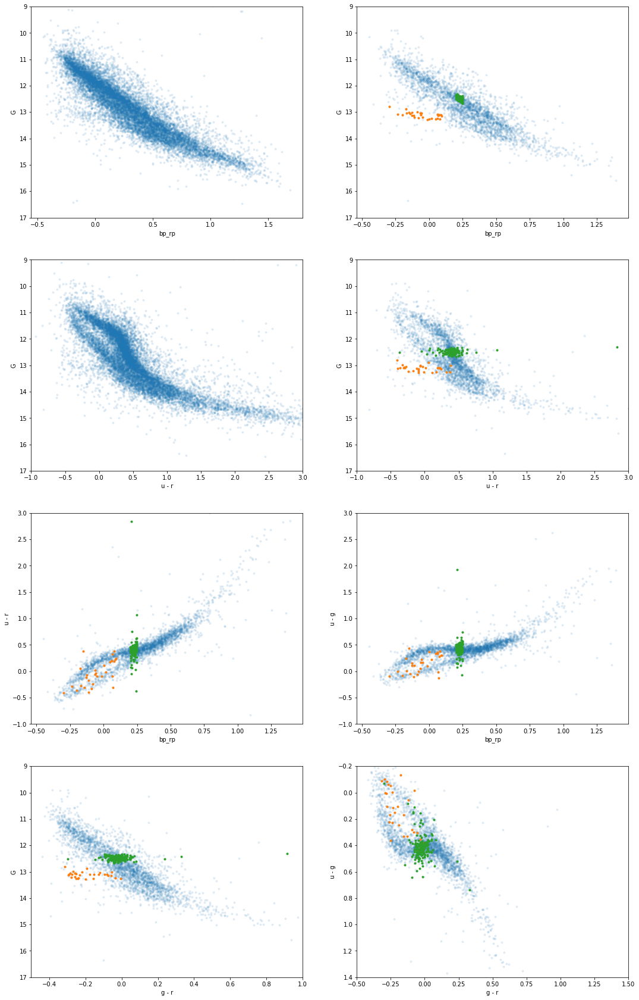

In [712]:
selected = selected_sdss
high_snr = ((d/e_d)[selected_WD][selected]>10)

x = WD_bp_rp
y = WD_G - WD_m_M
selected_mid = high_snr * ( np.abs(y[selected] - x[selected]*3.3 -12.1 ) < 0.1) *\
                    (x[selected]>0.20) * (x[selected]<0.25)
selected_up = high_snr * ( np.abs(y[selected] - x[selected]*3.3 -11.7 ) < 0.1) *\
                    (x[selected]>0.20) * (x[selected]<0.25)
selected_low = ( np.abs(y[selected] - x[selected]*0.7 -13.1 ) < 0.2) *\
                    (x[selected]>-0.40) * (x[selected]<0.1)
selected_mix =  ( np.abs((WD_u-WD_g)[selected] - x[selected]*1 - 0.2 ) < 0.05) *\
                (x[selected]>-0.40) * (x[selected]<0.1)
selected_low_spec = selected_mix * selected_low * selected_with_spec_bool  

selected_low_2 = high_snr * ( np.abs(y[selected] - x[selected]*1 -13.1 ) < 0.15) *\
                    (x[selected]>-0.40) * (x[selected]<0.10)
selected_low_2_spec = selected_low_2 * selected_with_spec_bool  


selected_bi = ( np.abs(y[selected] - x[selected]*3 -11.0 ) < 0.25) *\
                    (np.abs(x[selected]-0.5)<0.65)
selected_str = ( np.abs(sdss['u_mag'][selected] - sdss['g_mag'][selected] - 0.3 ) < 0.25) *\
                    (WD_bp_rp[selected]>0.75)
selected_DB = ( sdss['u_mag'][selected] - sdss['g_mag'][selected] < 0.35) *\
                    (y[selected]-11-5.2*(sdss['u_mag'][selected] - sdss['g_mag'][selected])>0)

magnetic = np.array([0,4,8,9,10])
alpha = 1
selected_a = selected_with_spec_bool * high_snr
selected_c = selected_low_2_spec
selected_b = selected_up#np.where((selected_low_2_spec==True))[0][magnetic]

#selected_b = selected_with_spec[DA]
#selected_c = selected_with_spec[DB]


color = WD_bp_rp
abs_mag = WD_r - WD_m_M
plt.figure(figsize=(18,30))
plt.subplot(4,2,1)
x = color
y = abs_mag
plt.plot(x[selected][high_snr],y[selected][high_snr],'.', alpha=0.1)
plt.scatter(x[i],y[i],c='r',s=10,alpha=1)
plt.ylim(17,9)
plt.xlabel('bp_rp');plt.ylabel('G')


plt.subplot(4,2,2)
#plt.plot(x[selected],(y[selected]),'.', alpha=0.1)
plt.plot(x[selected][selected_a],(y[selected])[selected_a],'.', alpha=alpha/10)
plt.plot(x[selected][selected_c],(y[selected])[selected_c],'.', alpha=alpha)
plt.plot(x[selected][selected_b],(y[selected])[selected_b],'.', alpha=alpha)
plt.ylim(17,9)
plt.xlabel('bp_rp');plt.ylabel('G')

plt.subplot(4,2,3)
x = (WD_u - WD_r)[selected]
y = abs_mag[selected]
plt.plot(x,y,'.',alpha=0.1)
plt.xlim(-1,3);plt.ylim(17,9);plt.xlabel('u - r'); plt.ylabel('G')

plt.subplot(4,2,4)
x = sdss['u_mag'][selected]-sdss['r_mag'][selected]
y = abs_mag[selected]
#plt.plot(x,y,'.',alpha=0.1)
plt.plot(x[selected_a],y[selected_a],'.',alpha=alpha/10)
plt.plot(x[selected_c],y[selected_c],'.',alpha=alpha)
plt.plot(x[selected_b],y[selected_b],'.',alpha=alpha)
#plt.axvline(0.35)
#plt.plot([0.5,0],[13.6,11])
plt.xlim(-1,3);plt.ylim(17,9);plt.xlabel('u - r'); plt.ylabel('G')

plt.subplot(4,2,5)
x = color
y = sdss['u_mag'][selected]-sdss['r_mag'][selected]
#plt.plot(x[selected],y,'.', alpha=0.1)
plt.plot(x[selected][selected_a],y[selected_a],'.', alpha=alpha/10)
plt.plot(x[selected][selected_c],y[selected_c],'.', alpha=alpha)
plt.plot(x[selected][selected_b],y[selected_b],'.', alpha=alpha)
plt.ylim(-1,3);plt.xlabel('bp_rp');plt.ylabel('u - r')

plt.subplot(4,2,6)
x = color
y = sdss['u_mag'][selected]-sdss['g_mag'][selected]
#plt.plot(x[selected],y,'.', alpha=0.1)
plt.plot(x[selected][selected_a],y[selected_a],'.', alpha=alpha/10)
plt.plot(x[selected][selected_c],y[selected_c],'.', alpha=alpha)
plt.plot(x[selected][selected_b],y[selected_b],'.', alpha=alpha)
plt.ylim(-1,3);plt.xlabel('bp_rp');plt.ylabel('u - g')

plt.subplot(4,2,7)
x = sdss['g_mag'][selected]-sdss['r_mag'][selected]
y = abs_mag[selected]
#plt.plot(x,y,'.',alpha=0.1)
plt.plot(x[selected_a],y[selected_a],'.',alpha=alpha/10)
plt.plot(x[selected_c],y[selected_c],'.',alpha=alpha)
plt.plot(x[selected_b],y[selected_b],'.',alpha=alpha)
plt.xlim(-.5,1);plt.ylim(17,9);plt.xlabel('g - r');plt.ylabel('G')

plt.subplot(4,2,8)
x = WD_bp_rp[selected]
x = sdss['g_mag'][selected]-sdss['r_mag'][selected]
y = sdss['u_mag'][selected]-sdss['g_mag'][selected]
#plt.plot(x,y,'.',alpha=0.1)
plt.plot(x[selected_a],y[selected_a],'.',alpha=alpha/10)
plt.plot(x[selected_c],y[selected_c],'.',alpha=alpha)
plt.plot(x[selected_b],y[selected_b],'.',alpha=alpha)
plt.xlim(-0.5,1.5);plt.ylim(1.4,-0.2);plt.xlabel('g - r'); plt.ylabel('u - g')
plt.show()

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in subtract
  This is separate from the ipykernel package so we can avoid doing imports until


(-14, -22)

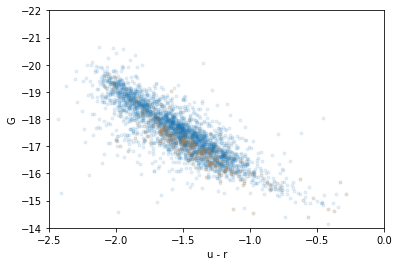

In [738]:
#plt.subplot(4,2,3)
#x = (WD_u - WD_g)[selected]
x = np.load('sdss_with_spec.npy')[0]['bp'] - np.load('sdss_with_spec.npy')[0]['rp']
#y = abs_mag[selected]
y = np.load('sdss_with_spec.npy')[0]['G'] - WD_m_M[selected][selected_with_spec]
#y = sdss['r_mag'][selected] - (5*np.log10(d.value*1000)-5)[selected]
plt.plot(x,y,'.',alpha=0.1)
plt.plot(x[low_B],y[low_B],'.',alpha=0.1)
#plt.axvline(0.35)
#plt.plot([0.5,0],[13.6,11])
plt.xlim(-2.5,0);plt.xlabel('u - r'); plt.ylabel('G')
plt.ylim(-14,-22)


In [745]:
WD[selected_WD][selected_sdss][selected_with_spec]

solution_id,designation,source_id,random_index,ref_epoch,ra,ra_error,dec,dec_error,parallax,parallax_error,parallax_over_error,pmra,pmra_error,pmdec,pmdec_error,ra_dec_corr,ra_parallax_corr,ra_pmra_corr,ra_pmdec_corr,dec_parallax_corr,dec_pmra_corr,dec_pmdec_corr,parallax_pmra_corr,parallax_pmdec_corr,pmra_pmdec_corr,astrometric_n_obs_al,astrometric_n_obs_ac,astrometric_n_good_obs_al,astrometric_n_bad_obs_al,astrometric_gof_al,astrometric_chi2_al,astrometric_excess_noise,astrometric_excess_noise_sig,astrometric_params_solved,astrometric_primary_flag,astrometric_weight_al,astrometric_pseudo_colour,astrometric_pseudo_colour_error,mean_varpi_factor_al,astrometric_matched_observations,visibility_periods_used,astrometric_sigma5d_max,frame_rotator_object_type,matched_observations,duplicated_source,phot_g_n_obs,phot_g_mean_flux,phot_g_mean_flux_error,phot_g_mean_flux_over_error,phot_g_mean_mag,phot_bp_n_obs,phot_bp_mean_flux,phot_bp_mean_flux_error,phot_bp_mean_flux_over_error,phot_bp_mean_mag,phot_rp_n_obs,phot_rp_mean_flux,phot_rp_mean_flux_error,phot_rp_mean_flux_over_error,phot_rp_mean_mag,phot_bp_rp_excess_factor,phot_proc_mode,bp_rp,bp_g,g_rp,radial_velocity,radial_velocity_error,rv_nb_transits,rv_template_teff,rv_template_logg,rv_template_fe_h,phot_variable_flag,l,b,ecl_lon,ecl_lat,priam_flags,teff_val,teff_percentile_lower,teff_percentile_upper,a_g_val,a_g_percentile_lower,a_g_percentile_upper,e_bp_min_rp_val,e_bp_min_rp_percentile_lower,e_bp_min_rp_percentile_upper,flame_flags,radius_val,radius_percentile_lower,radius_percentile_upper,lum_val,lum_percentile_lower,lum_percentile_upper,datalink_url,epoch_photometry_url
,,,,yr,deg,mas,deg,mas,mas,mas,,mas.yr**-1,mas.yr**-1,mas.yr**-1,mas.yr**-1,,,,,,,,,,,,,,,,,mas,,,,mas**-2,um**-1,um**-1,,,,mas,,,,,'electron'.s**-1,'electron'.s**-1,,mag,,'electron'.s**-1,'electron'.s**-1,,mag,,'electron'.s**-1,'electron'.s**-1,,mag,,,mag,mag,mag,km.s**-1,km.s**-1,,K,log(cm.s**-2),'dex',,deg,deg,deg,deg,,K,K,K,mag,mag,mag,mag,mag,mag,,Rsun,Rsun,Rsun,Lsun,Lsun,Lsun,,
int64,object,int64,int64,float64,float64,float64,float64,float64,float64,float64,float32,float64,float64,float64,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,int32,int32,int32,int32,float32,float32,float64,float64,int16,bool,float32,float64,float64,float32,int16,int16,float32,int32,int16,bool,int32,float64,float64,float32,float32,int32,float64,float64,float32,float32,int32,float64,float64,float32,float32,float32,int16,float32,float32,float32,float64,float64,int32,float32,float32,float32,object,float64,float64,float64,float64,int64,float32,float32,float32,float32,float32,float32,float32,float32,float32,int64,float32,float32,float32,float32,float32,float32,object,object
1635721458409799680,Gaia DR2 4415230812694612864,4415230812694612864,1274360781,2015.5,230.67593506350235,0.24919984628163394,-2.1121742214144787,0.1940421640036003,9.763503141151794,0.27512524506057434,35.487484,-39.50104565204121,0.4708899250402174,-42.22369553387704,0.4048241342389968,-0.038358334,-0.3879712,0.07209037,-0.15360571,-0.11975506,-0.11250493,0.29903024,-0.12843218,0.03210634,-0.026666433,134,0,133,1,0.16502446,129.98389,0.0,0.0,31,False,0.37662414,1.5948809524523362,0.06987652767322473,0.08046622,15,10,0.41771612,0,15,False,131,629.7799593907417,1.831252403611214,343.9067,18.690393,13,390.5774891332826,15.000452020161255,26.037714,18.87212,11,343.5186216226968,7.370851174419685,46.605015,18.422045,1.165639,0,0.45007515,0.18172646,0.2683487,--,--,0,--,--,--,NOT_AVAILABLE,0.27056074977485106,43.29764380726433,228.8209753699599,15.883737063842764,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,http://geadata.esac.esa.int/data-server/datalink/links?ID=4415230812694612864,--
1635721458409799680,Gaia DR2 932193312675997056,932193312675997056,1471362078,2015.5,124.24636312867054,0.1738059630543163,50.39863045812876,0.12355474849340596,4.2058195598415935,0.22850857303717287,18.405521,16.403255639392054,0.33848935463

29


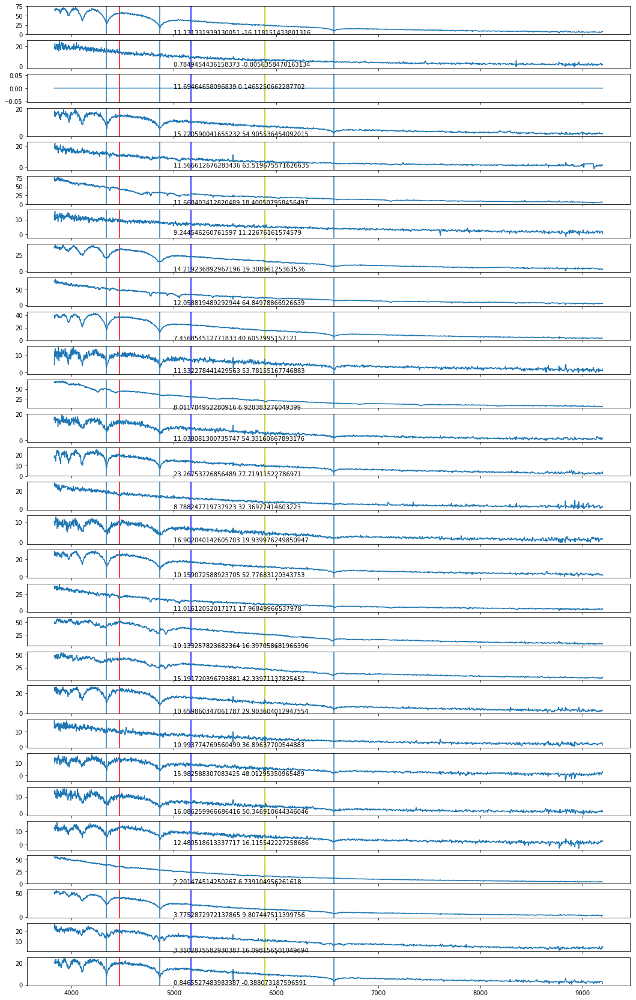

[0, 4, 8, 9, 10]

In [746]:
spec_selected = selected_low_2_spec[selected_with_spec]==True
#spec_selected = selected_mid[selected_with_spec]==True
ra_low_2_spec = WD[selected_WD][selected_sdss][selected_with_spec][spec_selected]['ra']
dec_low_2_spec = WD[selected_WD][selected_sdss][selected_with_spec][spec_selected]['dec']
print(spec_selected.sum())
n = spec_selected.sum()
fig, axes = plt.subplots(n,1, sharex='col',figsize=(18,30))
for i in range(n):
    axes[i].axvline(6563)
    axes[i].axvline(4861.3615)
    axes[i].axvline(4340.462)
    axes[i].axvline(5893,c='y')
    axes[i].axvline(4471,c='r')
    axes[i].axvline(5170.462,c='b')
    #axes[i].axvline(4340.462)
    axes[i].plot(lam_standard,spec[spec_index][spec_selected,:][i])
    axes[i].text(5000,0,str(ra_low_2_spec[i]/15)+' '+str(dec_low_2_spec[i]))
    
    #axes[i].axvline(2340)
    #axes[i].axvline(2380)
    #axes[i].axvline(2300)
plt.show()
[0,4,8,9,10]

### pure Gaia result

In [710]:
xmin = -0.40
xmax = 0.10
offset = 13.1
width = 0.15
slope = 1
func = lambda x, offset, slope: offset+x*slope

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)


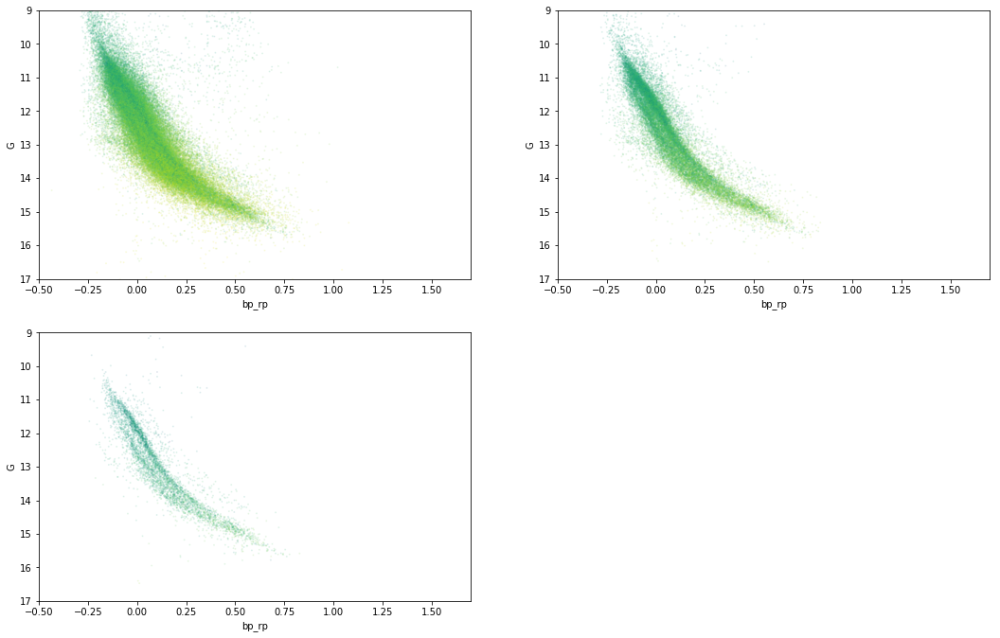

In [937]:
selected = ((d/e_d)[selected_WD]>30) * (d[selected_WD].value<0.1)

x = WD_G - WD_rp
y = WD_bp - WD_m_M
selected_mid = ( np.abs(y[selected] - x[selected]*3.2 -12.1 ) < 0.15) *\
                    (x[selected]>-0.00) * (x[selected]<0.6)
selected_up = ( np.abs(y[selected] - x[selected]*3 -11.7 ) < 0.25) *\
                    (np.abs(x[selected]-0.2)<0.85)
#selected_low = ( np.abs(y[selected] - x[selected]*2.4 -13.1 ) < 0.2) *\
#                    (x[selected]>-0.30) * (x[selected]<0.6)
#selected_low = ( np.abs(y[selected] - x[selected]*0.7 -13.1 ) < 0.2) *\
#                    (x[selected]>-0.40) * (x[selected]<1.2)
selected_low = ( np.abs(y[selected] - x[selected]*slope -offset ) < width) *\
                    (x[selected]>xmin) * (x[selected]<xmax)
selected_bi = ( np.abs(y[selected] - x[selected]*3 -11.0 ) < 0.25) *\
                    (np.abs(x[selected]-0.5)<0.65)
selected_str = ( np.abs(sdss['u_mag'][selected] - sdss['g_mag'][selected] - 0.3 ) < 0.25) *\
                    (WD_bp_rp[selected]>0.75)
selected_DB = ( sdss['u_mag'][selected] - sdss['g_mag'][selected] < 0.35) *\
                    (y[selected]-11-5.2*(sdss['u_mag'][selected] - sdss['g_mag'][selected])>0)
    

alpha = 0.01

selected_a = selected_up
selected_b = selected_low
selected_c = selected_mid

color = WD_bp - WD_G
abs_mag = WD_G - WD_m_M
plt.figure(figsize=(18,24))

for i,snr in enumerate([10,30,100]):
    plt.subplot(4,2,i+3)
    selected = ((d/e_d)[selected_WD]>snr) * (d[selected_WD].value<1)
    plt.scatter(color[selected],abs_mag[selected],s=1,c=WD[selected_WD][selected]['phot_g_mean_mag'],alpha=0.1)
    #plt.plot([xmin, xmin, xmax, xmax, xmin],\
    #         [func(xmin,offset,slope)-width,func(xmin,offset,slope)+width,func(xmax,offset,slope)+width,func(xmax,offset,slope)-width,\
    #          func(xmin,offset,slope)-width ])                  
    plt.xlim(-0.5,1.7)
    plt.ylim(17,9)
    plt.xlabel('bp_rp');plt.ylabel('G')

plt.show()

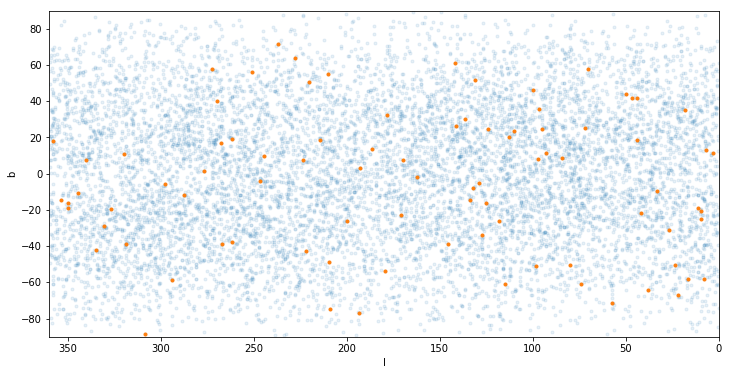

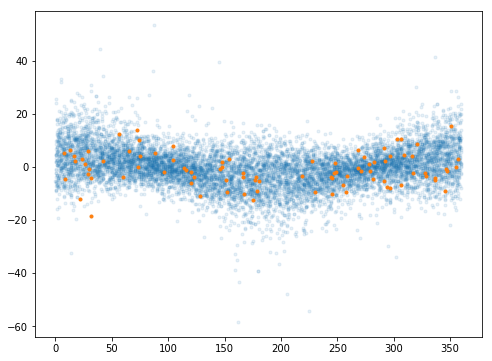

In [912]:
#selected = selected_sdss
selected = ((d/e_d)[selected_WD]>30) * (d[selected_WD].value<0.1)
alpha=1
selected_a = selected_up
selected_b = selected_low
selected_c = selected_mid

plt.figure(figsize=(12,6))
x = WD['l'][selected_WD][selected]
y = WD['b'][selected_WD][selected]
plt.plot(x,y,'.',alpha=0.1)
#plt.plot(x[selected_c],y[selected_c],'.',alpha=alpha)
#plt.plot(x[selected_a],y[selected_a],'.',alpha=alpha)
plt.plot(x[selected_b],y[selected_b],'.',alpha=alpha)
plt.xlim(360,0);plt.ylim(-90,90);plt.xlabel('l');plt.ylabel('b')
plt.show()

plt.figure(figsize=(8,6))
x = WD['ra'][selected_WD][selected]
y = (pmra*d)[selected_WD][selected]
plt.plot(x,y,'.',alpha=0.1)
#plt.plot(x[selected_c],y[selected_c],'.',alpha=alpha)
#plt.plot(x[selected_a],y[selected_a],'.',alpha=alpha)
plt.plot(x[selected_b],y[selected_b],'.',alpha=alpha)
#plt.xlim(-200,200);plt.ylim(-200,200);plt.xlabel('i - z');plt.ylabel('G')
#plt.ylim(-20,20)
plt.show()

## Pulsating WD

73067


/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log10
  del sys.path[0]


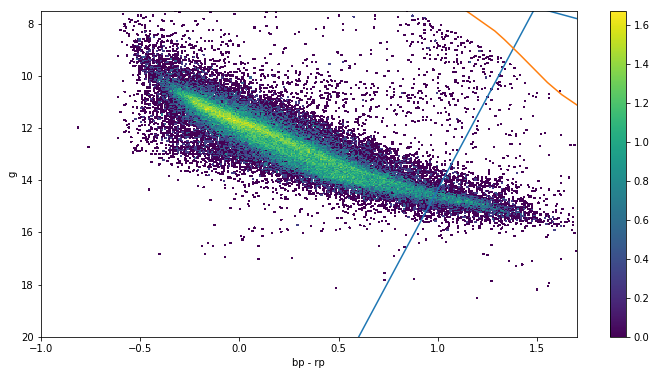

In [11]:
#plt.figure(figsize=(6,6))
selected = (\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
             * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)
                     )
print(selected.sum())
x = bp_rp
y = g - (5*np.log10(d.value*1000)-5) #- table['a_g_val']


plt.figure(figsize=(12,6))
H, xedges, yedges = np.histogram2d(x[selected], y[selected], bins=(400, 300),range=((-1,1.7),(7.5,20)))
H = H.T
X_display, Y_display = np.meshgrid(xedges, yedges)
plt.pcolormesh(X_display, Y_display, np.log10(H))

#plt.legend()
plt.colorbar()

#plt.title(key)
plt.ylim(20,7.5)
plt.xlim(-1,1.7)
plt.xlabel('bp - rp')
plt.ylabel('g')

plt.plot((isochrone_sun['G_BPmag']-isochrone_sun['G_RPmag']), isochrone_sun['Gmag'],'-')
#plt.plot((isochrone_sun['G_BPmag']-isochrone_sun['G_RPmag']), isochrone_sun['Gmag']+5,'-')
plt.plot((isochrone_mpoor['G_BP']-isochrone_mpoor['G_RP']), isochrone_mpoor['G'],'-')

x_line = np.array([0,6])
line = lambda x: 1.77*(x-1)+0
plt.plot(x_line, line(x_line))
plt.plot(x_line, line(x_line)-1)

plt.show()

## $$\sigma_{obs} = \textrm{flux error}\times\sqrt{Nt} $$
## $$\sigma_{poisson} = \sqrt{\textrm{flux}\times Nt}\textrm{, sky background negligible?}$$ 
## $$\textrm{phot noise excess}=\frac{\sigma_{obs}}{\sigma_{poisson}}$$

In [12]:
phot_noise_excess = table['phot_g_mean_flux_error']*4.4/(table['phot_g_mean_flux']*4.4/table['phot_g_n_obs'])**0.5

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: divide by zero encountered in log10
  


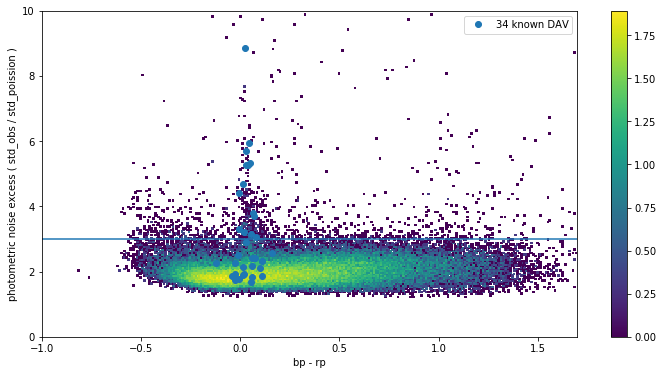

In [13]:
#plt.figure(figsize=(6,6))
selected = (\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
             * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)
                     )

x = bp_rp
z = g

y = phot_noise_excess

plt.figure(figsize=(12,6))
H, xedges, yedges = np.histogram2d(x[selected], y[selected], bins=(300, 200),range=((-1,1.7),(0,10)))
H = H.T
X_display, Y_display = np.meshgrid(xedges, yedges)
plt.pcolormesh(X_display, Y_display, np.log10(H))
plt.colorbar()

plt.plot(x[DAV_index],y[DAV_index],'o',label='34 known DAV')
plt.axhline(3)
plt.legend()

plt.ylim(0,10)
plt.xlim(-1,1.7)
plt.xlabel('bp - rp')
plt.ylabel('photometric noise excess ( std_obs / std_poission )')

plt.show()

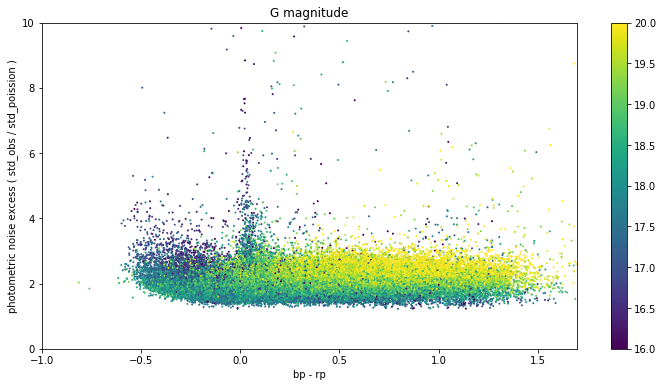

In [14]:
#plt.figure(figsize=(6,6))
selected = (\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
             * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)
                     )

x = bp_rp
z = g

y = phot_noise_excess

plt.figure(figsize=(12,6))
plt.scatter(x[selected],y[selected],c=table['phot_g_mean_mag'][selected],s=1,vmin=16,vmax=20)
plt.colorbar()

plt.ylim(0,10)
plt.xlim(-1,1.7)
plt.xlabel('bp - rp')
plt.ylabel('photometric noise excess ( std_obs / std_poission )')
plt.title('G magnitude')

plt.show()

73067


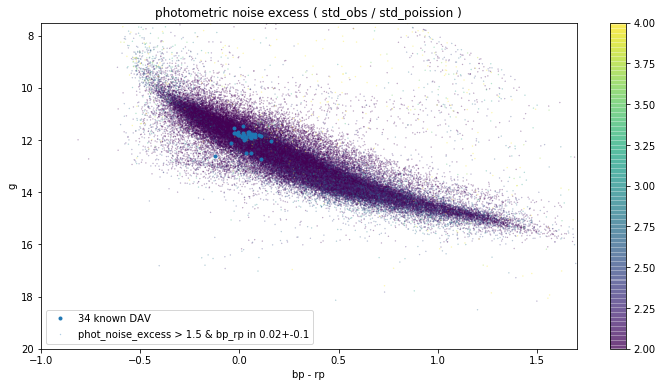

In [15]:
selected = (\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
               * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)\
           )# * (np.abs(bp_rp-0.02)<0.1)
print(selected.sum())

x = bp_rp
y = g - (5*np.log10(d.value*1000)-5) #- table['a_g_val']
z = phot_noise_excess

plt.figure(figsize=(12,6))
plt.scatter(x[selected],y[selected],c=z[selected],\
            s=0.1, vmin=2, vmax=4, alpha=0.5,label='phot_noise_excess > 1.5 & bp_rp in 0.02+-0.1')
plt.colorbar()

plt.plot(x[DAV_index],y[DAV_index],\
            '.',label='34 known DAV')
plt.legend()

plt.ylim(20,7.5)
plt.xlim(-1,1.7)

#plt.ylim(12.5,11)
#plt.xlim(-0.2,0.1)
plt.xlabel('bp - rp')
plt.ylabel('g')
plt.title('photometric noise excess ( std_obs / std_poission )')
plt.show()

403
1368


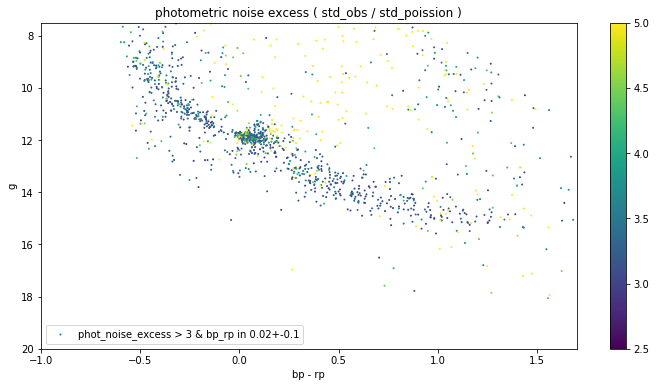

In [16]:
selected = (\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
               * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)\
           * (phot_noise_excess>3)\
            * (np.abs(bp_rp-0.02)<0.1)
           )# * (np.abs(bp_rp-0.02)<0.1)
print(selected.sum())

selected = (\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
               * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)\
           * (phot_noise_excess>3)\
           )
print(selected.sum())

x = bp_rp
y = g - (5*np.log10(d.value*1000)-5) #- table['a_g_val']
z = phot_noise_excess

plt.figure(figsize=(12,6))
plt.scatter(x[selected],y[selected],c=z[selected],\
            s=1, vmin=2.5, vmax=5, alpha=1,label='phot_noise_excess > 3 & bp_rp in 0.02+-0.1')
plt.colorbar()

#plt.plot(x[DAV_index],y[DAV_index],\
#            '.',label='34 known DAV')
plt.legend()

plt.ylim(20,7.5)
plt.xlim(-1,1.7)

#plt.ylim(12.5,11)
#plt.xlim(-0.2,0.1)
plt.xlabel('bp - rp')
plt.ylabel('g')
plt.title('photometric noise excess ( std_obs / std_poission )')
plt.show()

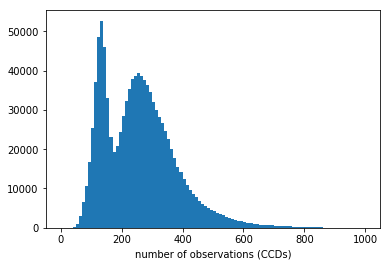

In [17]:
plt.hist(table['phot_g_n_obs'],100,(0,1000))
plt.xlabel('number of observations (CCDs)')
plt.show()

1474


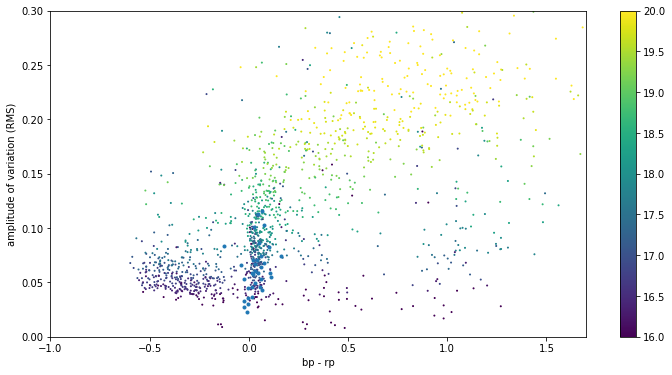

In [18]:
selected = (\
                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)\
             * ((g - (5*np.log10(d.value*1000)-5)-10)-4*(bp_rp-1.5)>0)\
            * (table['phot_g_mean_flux_error']/(table['phot_g_mean_flux']/table['phot_g_n_obs'])**0.5>2/1.414)
                     )
print(selected.sum())

x = bp_rp
z = g
y = ((table['phot_g_mean_flux_error']/table['phot_g_mean_flux'])**2*table['phot_g_n_obs']*4.4-1/table['phot_g_mean_flux'])**0.5

plt.figure(figsize=(12,6))
plt.scatter(x[selected],y[selected],c=z[selected],\
            s=1, vmin=16, vmax=20, alpha=1)
plt.colorbar()

plt.plot(x[DAV_index],y[DAV_index],\
            '.',label='34 known DAV')

plt.ylim(0,0.3)
plt.xlim(-1,1.7)

plt.xlabel('bp - rp')
plt.ylabel('amplitude of variation (RMS)')
plt.show()

In [19]:
len(z[DAV_index])

34

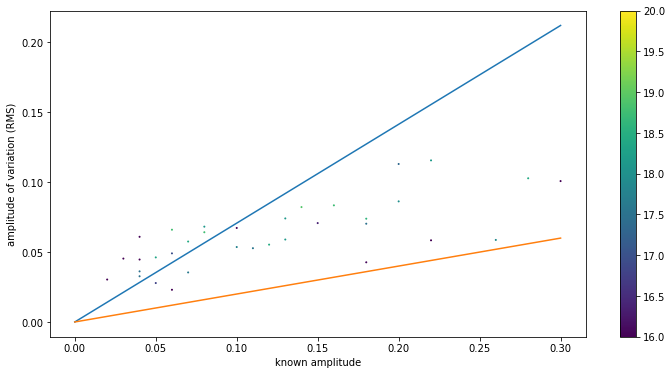

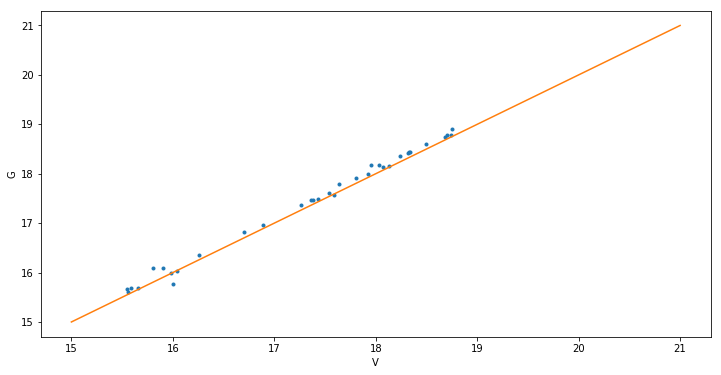

In [23]:
x = DAV_known['amp']
z = g
y = ((table['phot_g_mean_flux_error']/table['phot_g_mean_flux'])**2*table['phot_g_n_obs']*4.4-1/table['phot_g_mean_flux'])**0.5

plt.figure(figsize=(12,6))
plt.scatter(x[DAV_selected]/100,y[DAV_index],c=z[DAV_index],\
            s=1, vmin=16, vmax=20, alpha=1)
plt.colorbar()

plt.plot([0,0.3],[0,0.3/np.sqrt(2)])
plt.plot([0,0.3],[0,0.3*0.2])

plt.xlabel('known amplitude')
plt.ylabel('amplitude of variation (RMS)')
plt.show()

x = DAV_known['V']
z = g
y = table['phot_g_mean_mag']
      
plt.figure(figsize=(12,6))
plt.plot(x[DAV_selected],y[DAV_index],'.')

plt.plot([15,21],[15,21])

plt.xlabel('V')
plt.ylabel('G')
plt.show()

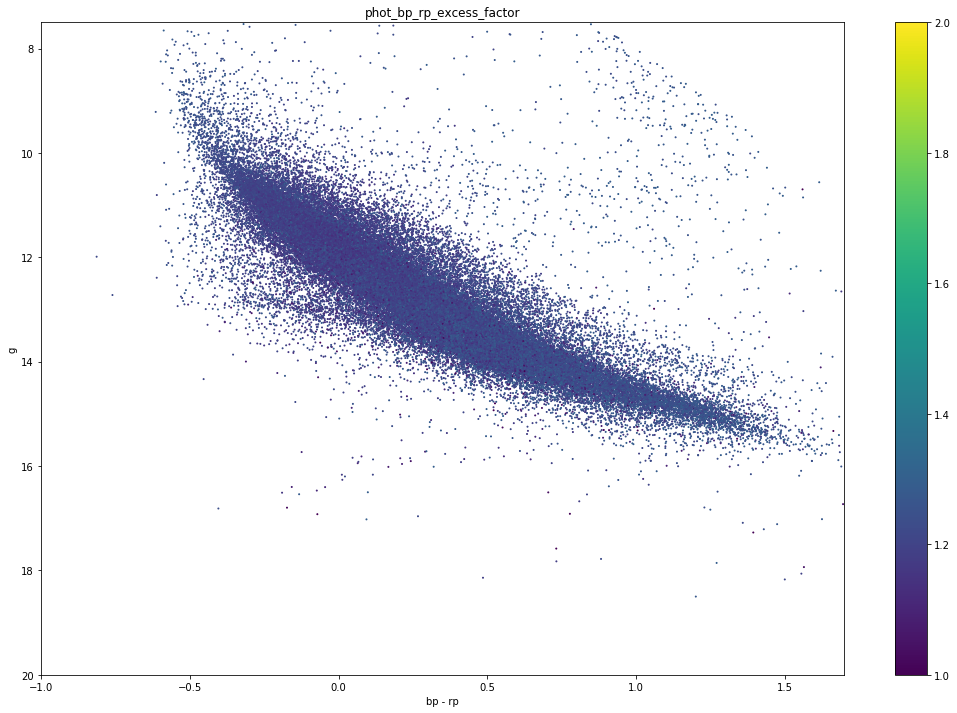

In [14]:
#selected = (\
#                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
#              * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)
#                    )


key = 'phot_bp_rp_excess_factor'
x = bp_rp
y = g - (5*np.log10(d.value*1000)-5) #- table['a_g_val']
z = table[key]

plt.figure(figsize=(18,12))
plt.scatter(x[selected],y[selected],c=z[selected],\
            s=1, vmin=1, vmax=2)

plt.colorbar()
plt.ylim(20,7.5)
plt.xlim(-1,1.7)
plt.xlabel('bp - rp')
plt.ylabel('g')
plt.title(key)
plt.show()

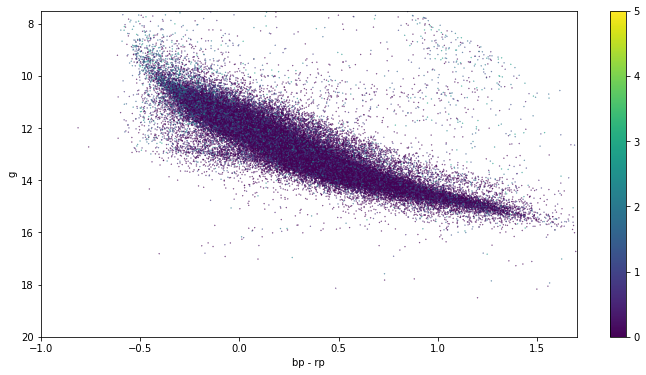

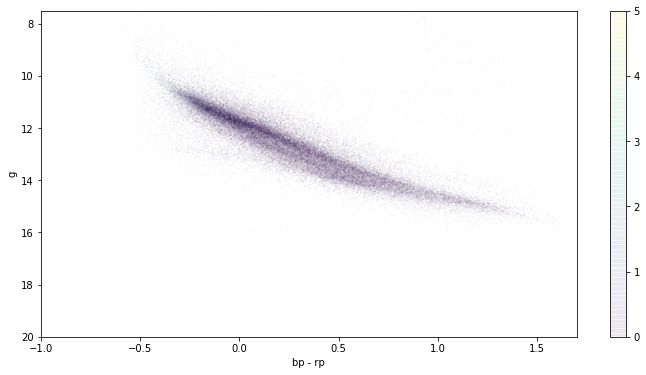

In [280]:
selected = selected_WD
x = bp_rp
y = g - (5*np.log10(d.value*1000)-5) #- table['a_g_val']
z = table['astrometric_excess_noise_sig']
plt.figure(figsize=(12,6))
plt.scatter(x[selected],y[selected],c=z[selected],\
            s=0.1, vmin=0, vmax=5)

plt.colorbar()
plt.ylim(20,7.5)
plt.xlim(-1,1.7)
plt.xlabel('bp - rp')
plt.ylabel('g')
plt.show()

plt.figure(figsize=(12,6))
plt.scatter(x[selected],y[selected],c=z[selected],\
            s=0.1, vmin=0, vmax=5,alpha=0.05)

plt.colorbar()
plt.ylim(20,7.5)
plt.xlim(-1,1.7)
plt.xlabel('bp - rp')
plt.ylabel('g')
plt.show()

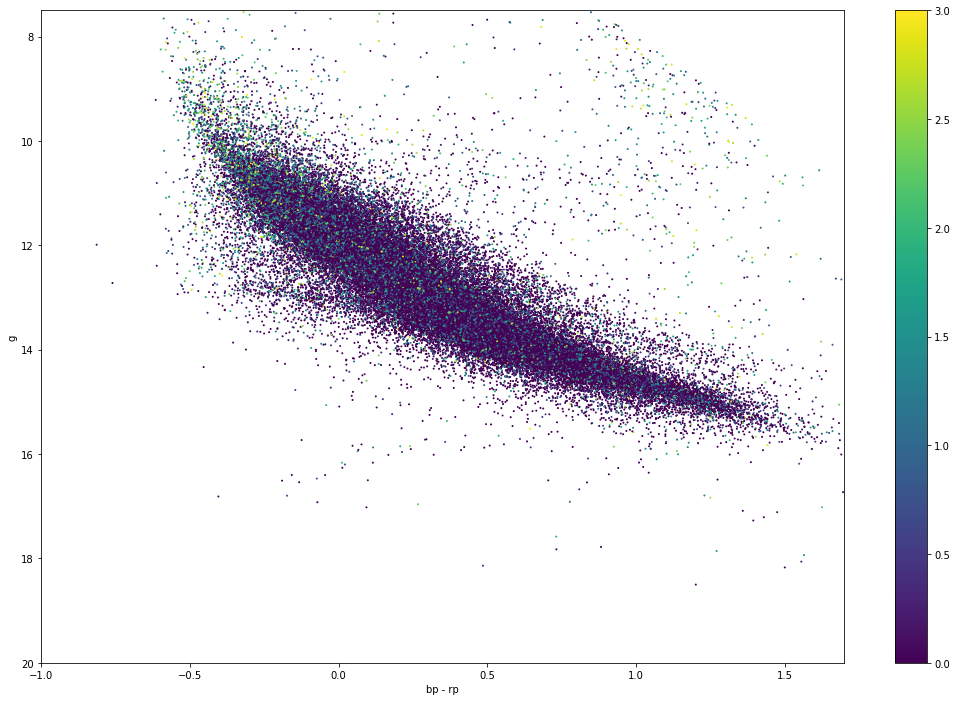

In [13]:
#selected = (\
#                  (d > 0) * (d.value<10) * (np.abs(Z.value+0.03)<0.2) * (np.abs(X.value-5)<122.5) * (d/e_d>10)\
#             * (table['phot_bp_rp_excess_factor']<1.3)* (table['astrometric_excess_noise_sig']<3)
#                     )

x = bp_rp
y = g - (5*np.log10(d.value*1000)-5) #- table['a_g_val']
z = table['astrometric_excess_noise_sig']

plt.figure(figsize=(18,12))
plt.scatter(x[selected],y[selected],c=z[selected],\
            s=1, vmin=0, vmax=3)

plt.colorbar()
plt.ylim(20,7.5)
plt.xlim(-1,1.7)
plt.xlabel('bp - rp')
plt.ylabel('g')
plt.show()

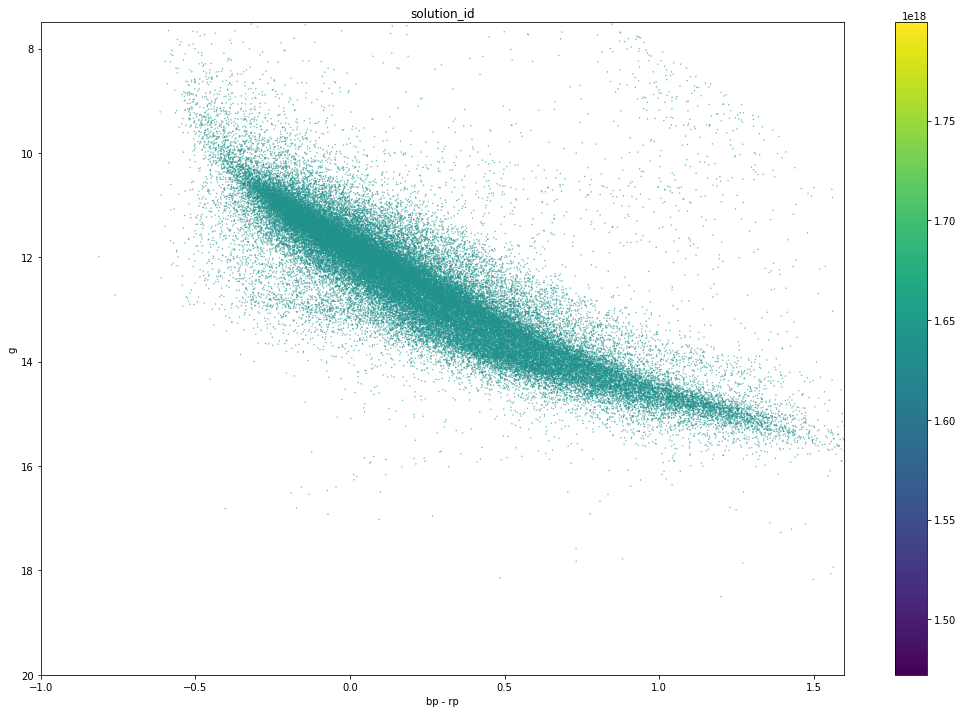

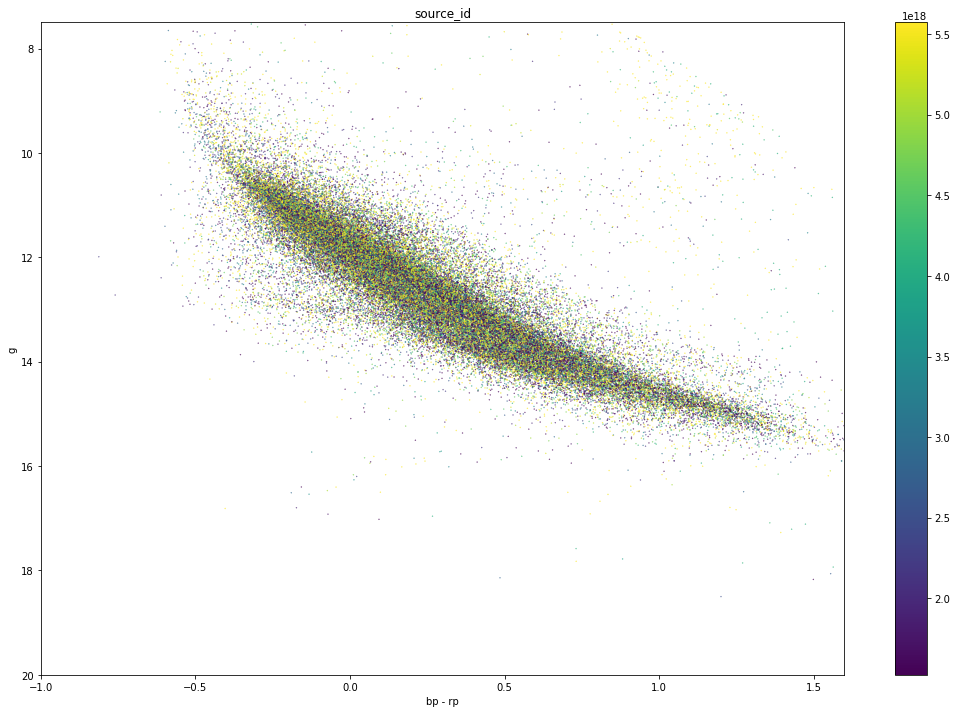

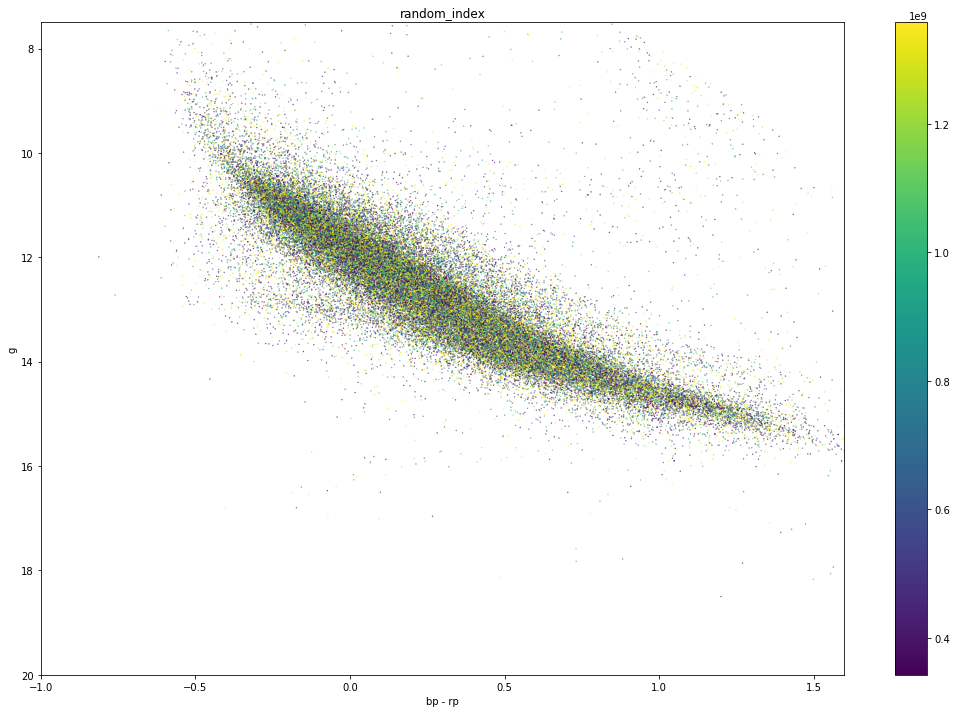

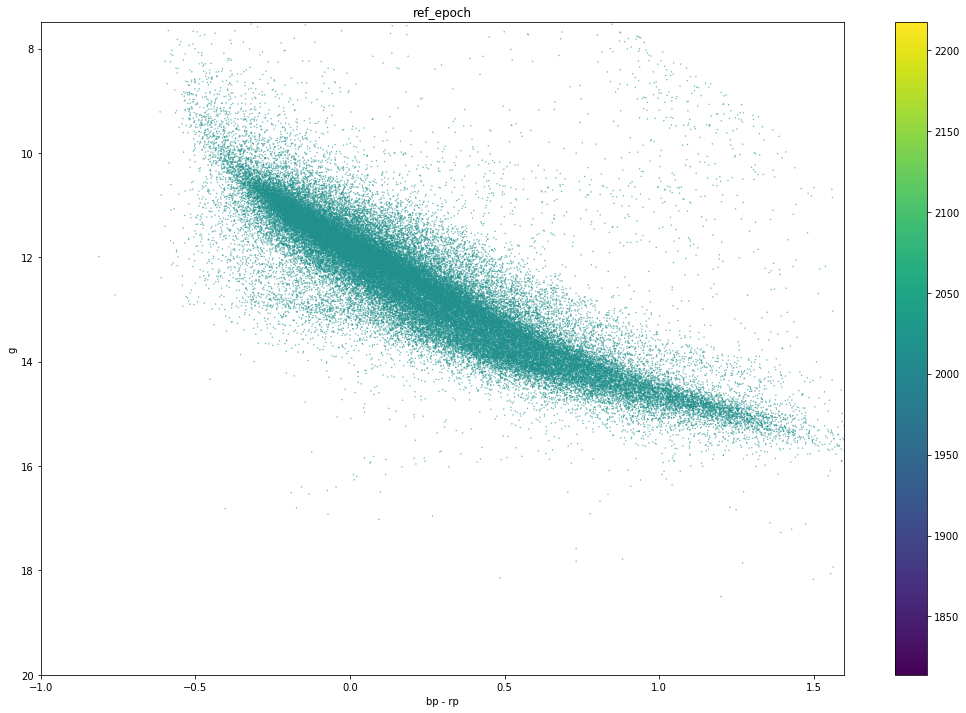

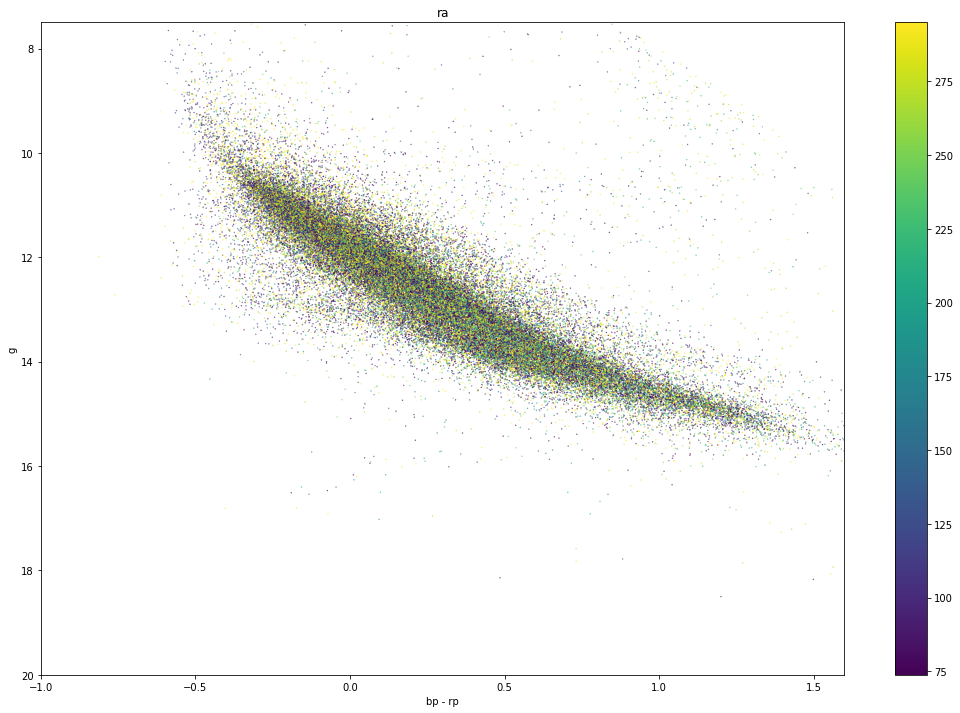

...

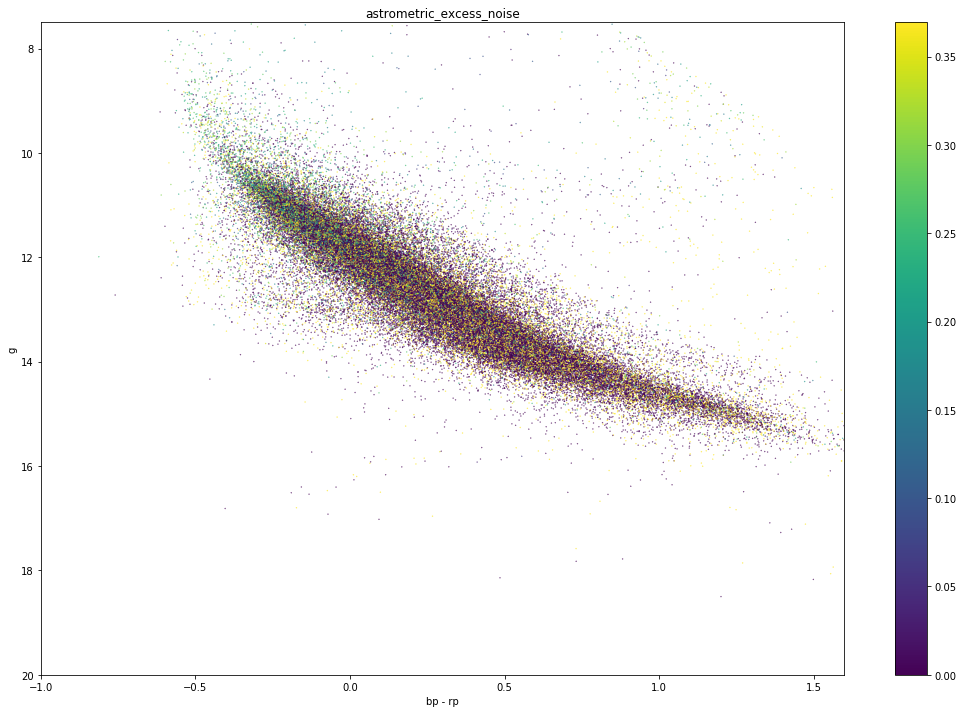

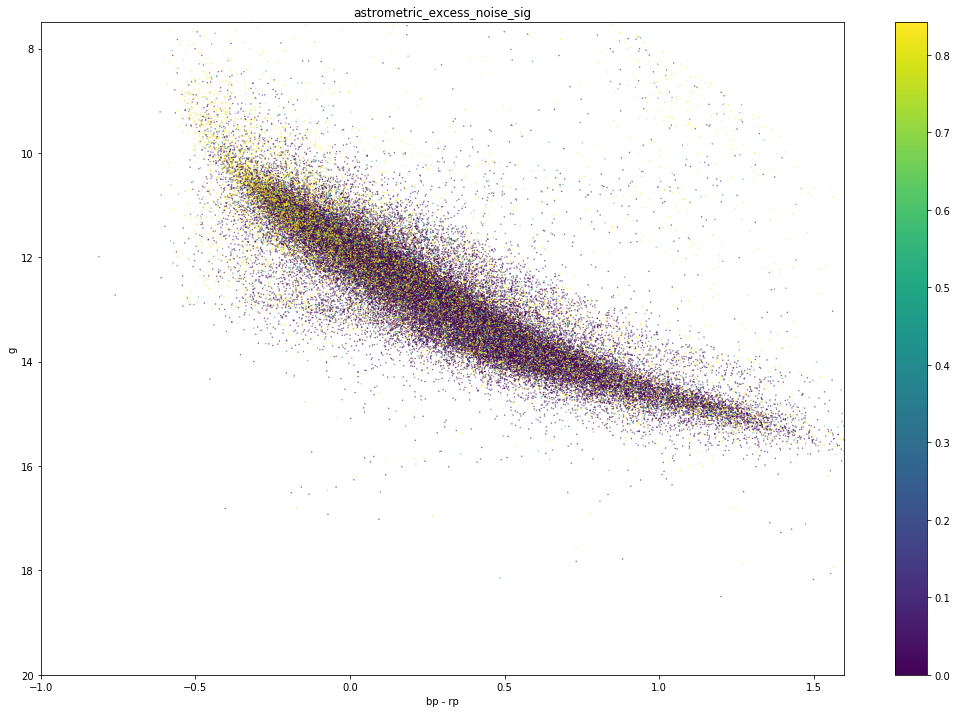

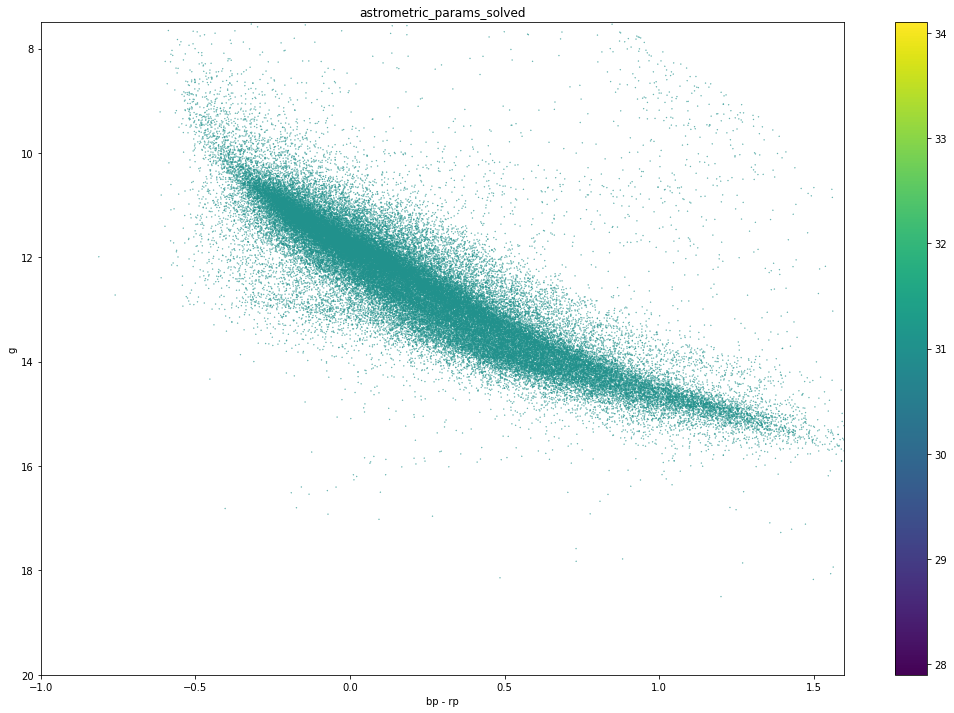

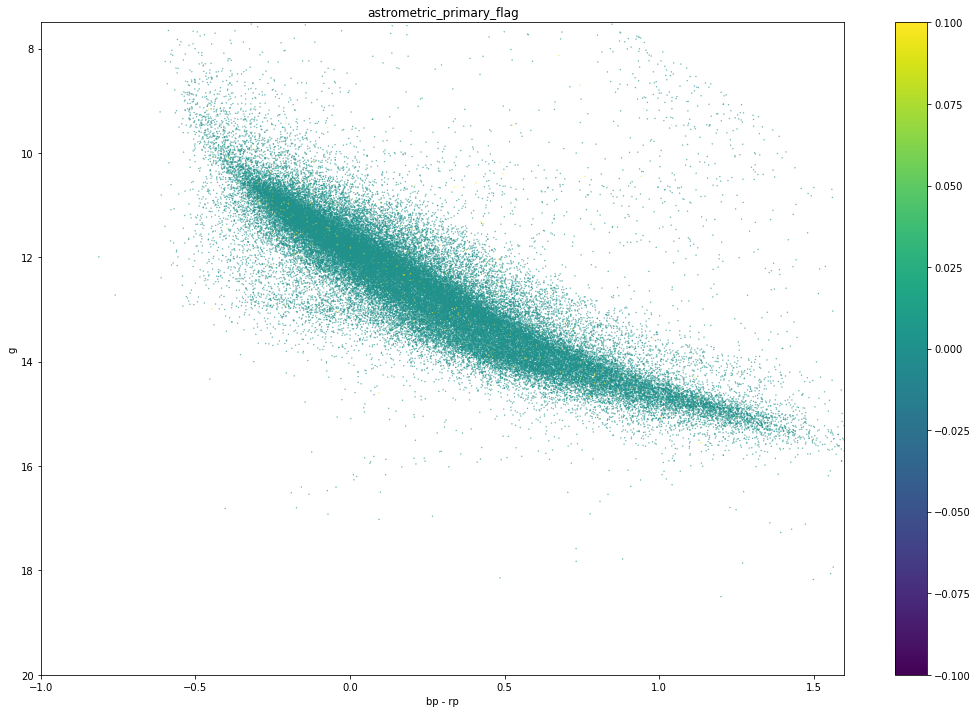

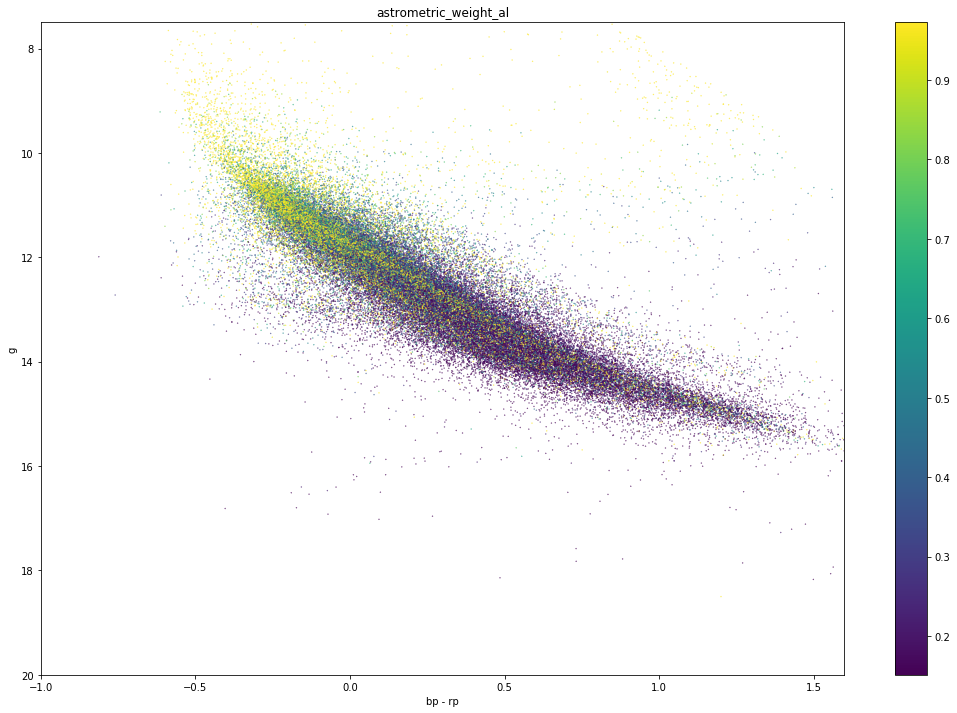

/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:4291: RuntimeWarning: Invalid value encountered in percentile
  interpolation=interpolation)


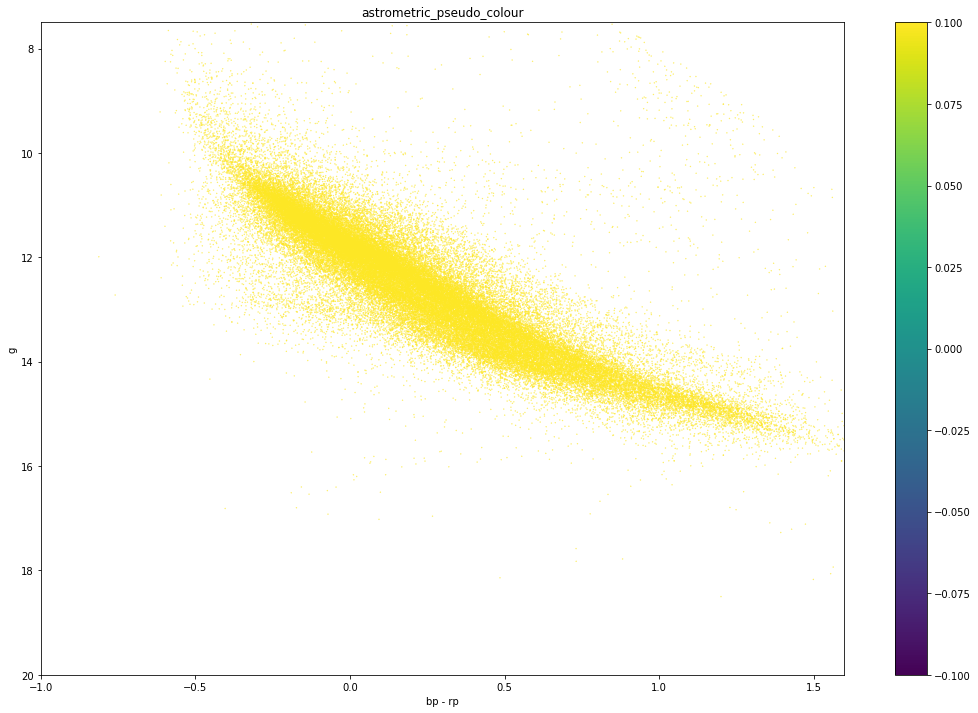

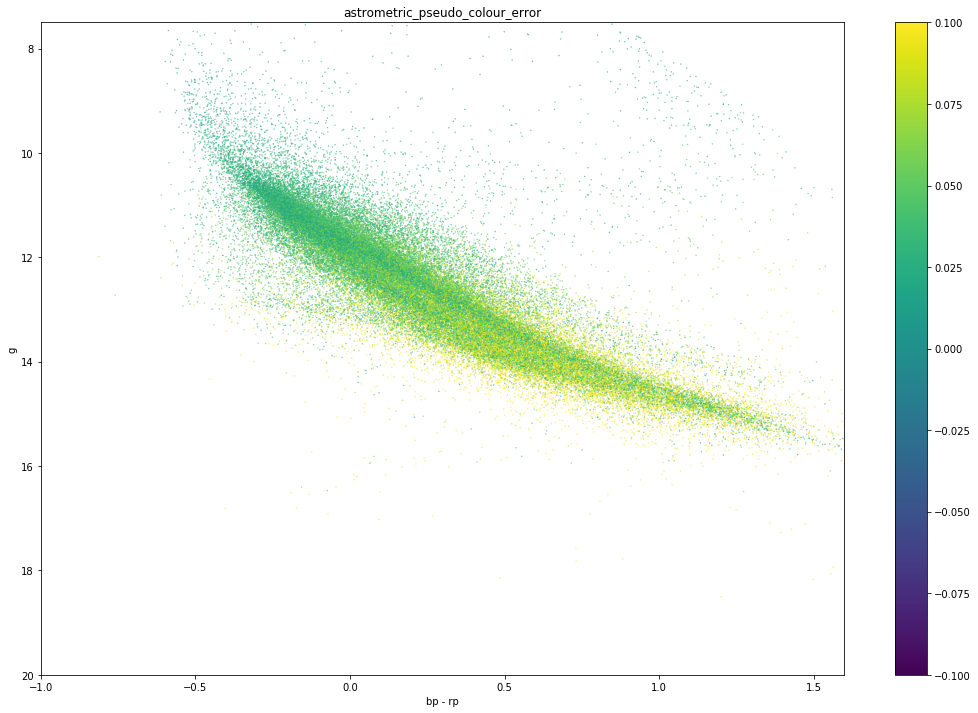

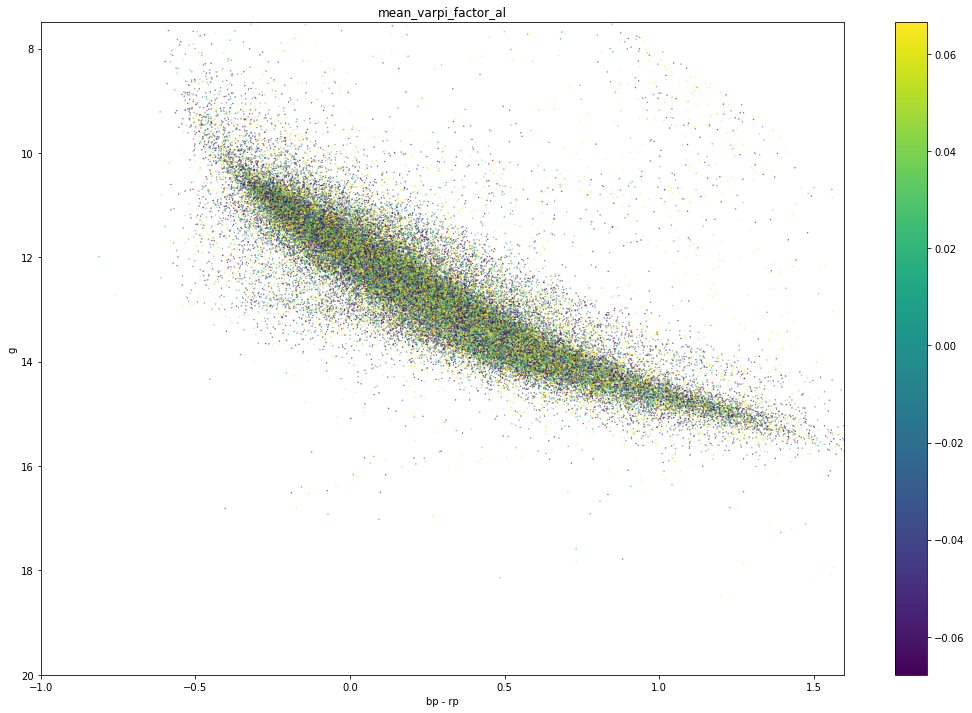

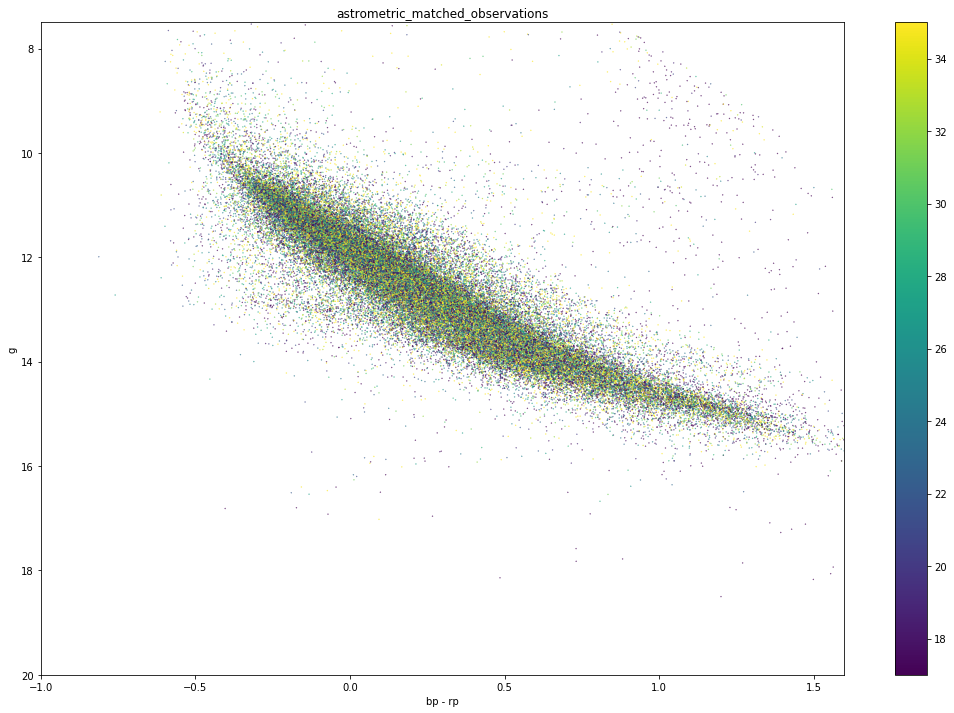

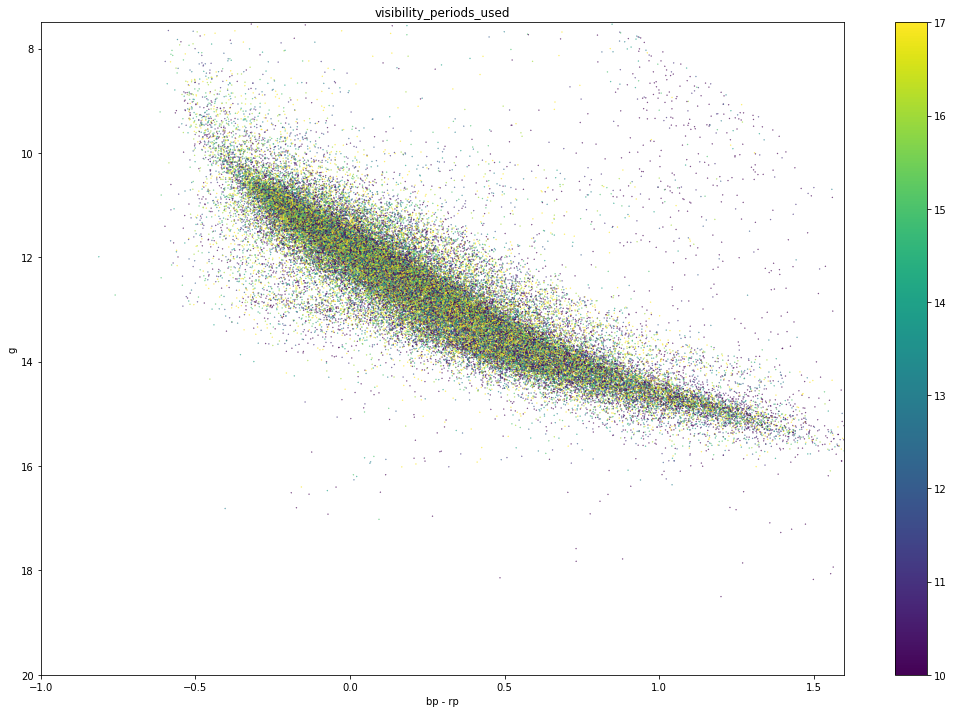

...

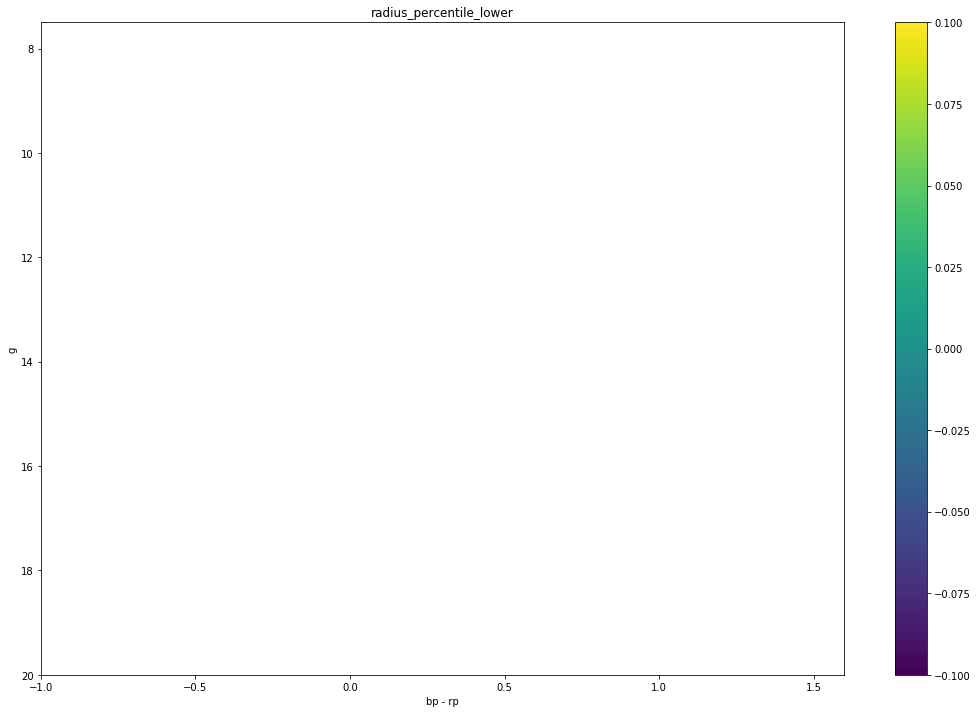

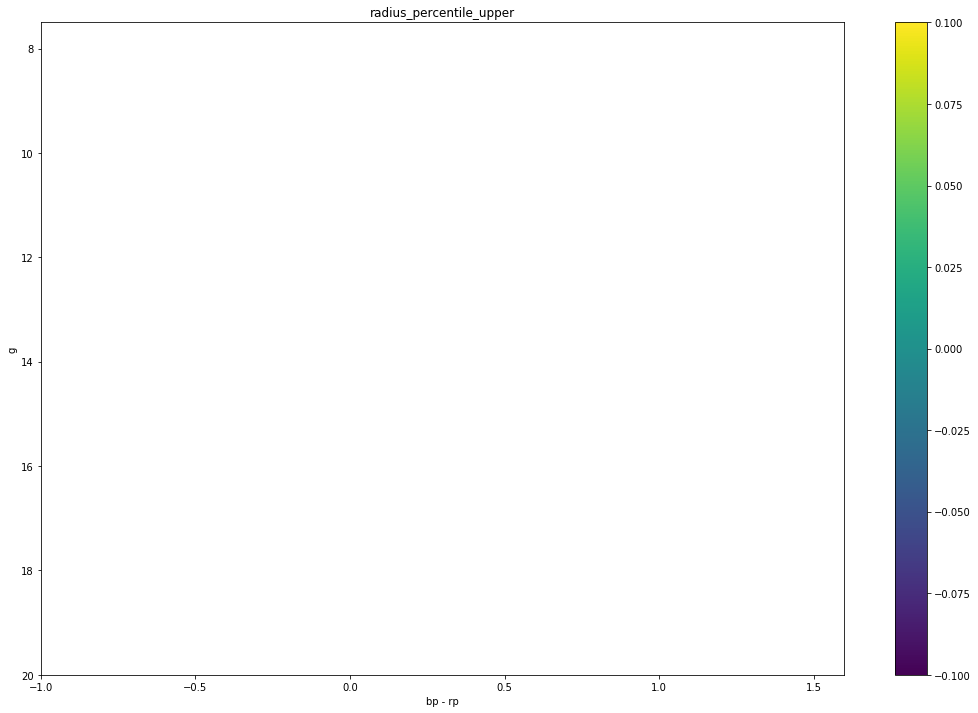

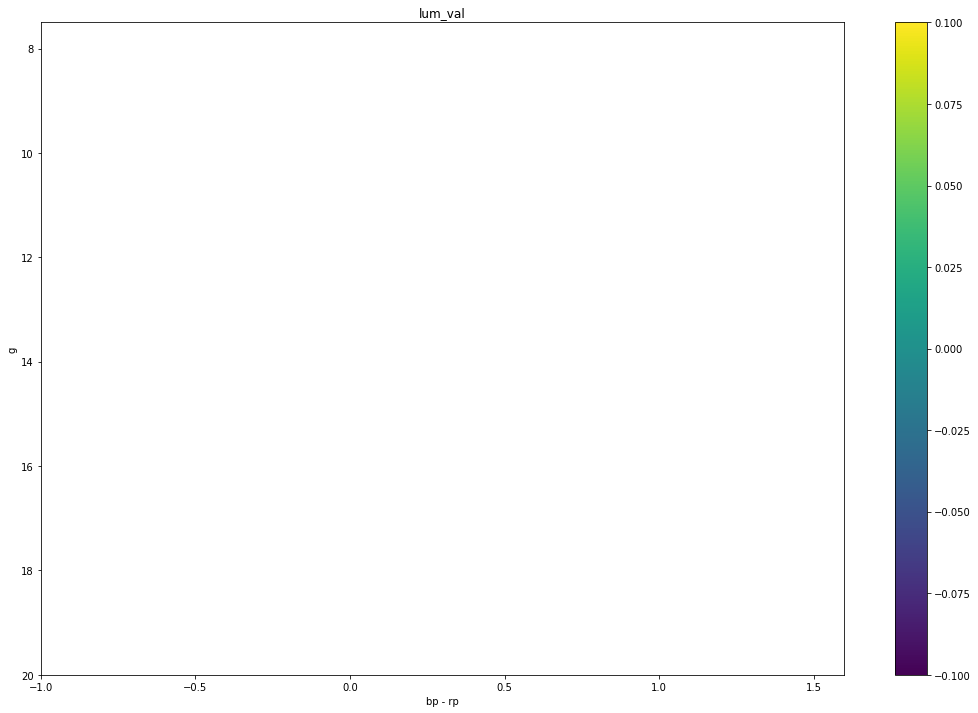

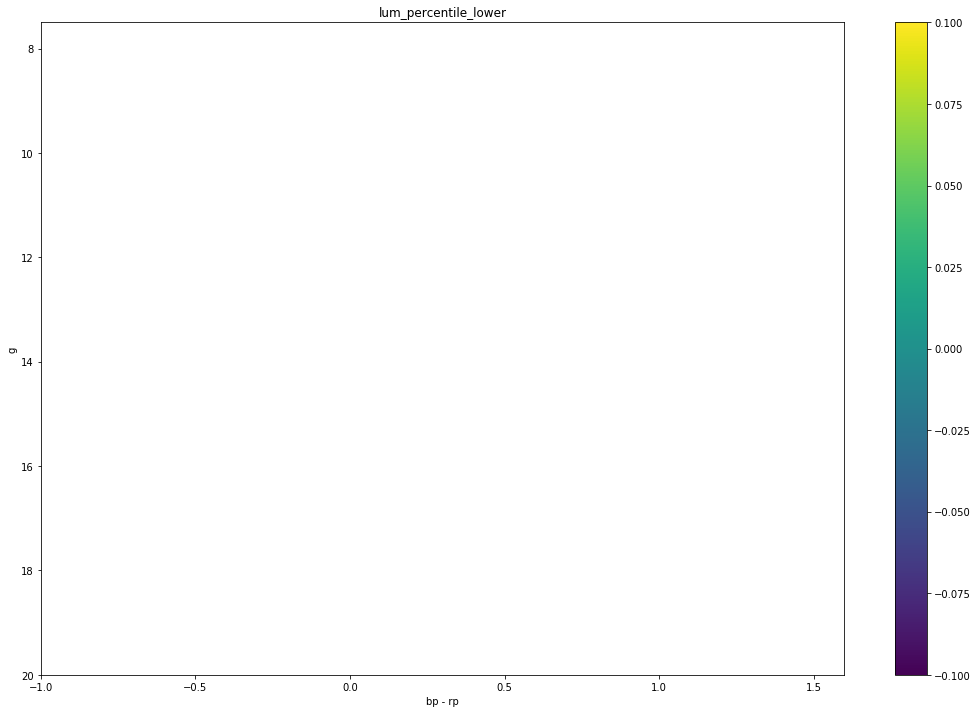

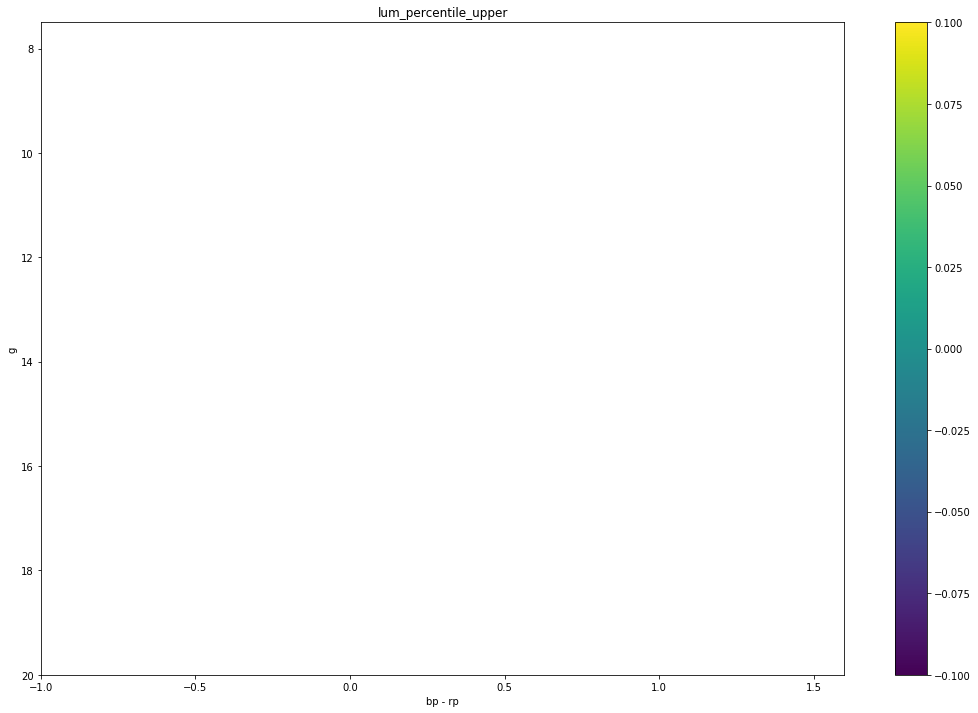

In [26]:
selected = selected_WD
for key in table.keys():
    try:
        selected = selected_WD

        x = bp_rp
        y = g - (5*np.log10(d.value*1000)-5) #- table['a_g_val']
        z = table[key]
        
        plt.figure(figsize=(18,12))
        plt.scatter(x[selected],y[selected],c=z[selected],\
                    s=0.1, vmin=np.percentile(table[key][selected],20), vmax=np.percentile(table[key][selected],80),alpha=1)

        plt.title(key)
        plt.colorbar()
        plt.ylim(20,7.5)
        plt.xlim(-1,1.6)
        plt.xlabel('bp - rp')
        plt.ylabel('g')
        plt.show()
    except BaseException:
        ;
               

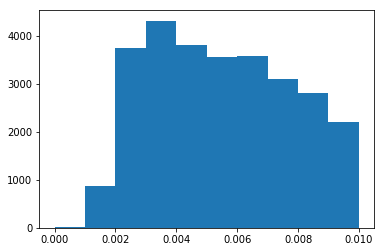

In [34]:
plt.hist(table['phot_g_mean_flux_error']/(table['phot_g_mean_flux']*table['phot_g_n_obs'])**0.5,range=(0,0.01))
plt.show()